#### Loading Library

In [151]:
import pandas as pd
import numpy as np
import os, chardet, glob
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import RandomForestRegressor

from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split, cross_validate, cross_val_predict, cross_val_score

from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, VotingRegressor

from sklearn.linear_model import LinearRegression
import statsmodels.api as sm

from sklearn.metrics import explained_variance_score, mean_absolute_error, mean_squared_error, r2_score, mean_absolute_percentage_error
import tensorflow as tf
from tensorflow.keras import Sequential, optimizers, losses, layers

%matplotlib inline

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
%matplotlib inline

In [7]:
df_overview = pd.read_excel('Overview.xlsx')
df_overview = df_overview.drop(['Unnamed: 13','Note'], axis=1)
df_overview = df_overview.dropna()
df_overview.rename(columns = {'Unnamed: 8':'SoC difference'}, inplace = True)
df_overview.head(45)

,Trip,Date,Route/Area,Weather,Battery Temperature (Start) [°C],Battery Temperature (End),Battery State of Charge (Start),Battery State of Charge (End),SoC difference,Ambient Temperature (Start) [°C],Target Cabin Temperature,Distance [km],Duration [min],Fan
0,TripA01,2019-06-25_13-21-14,Munich East,sunny,21.0,22.0,0.863,0.803,0.060,25.5,23.0,7.427690,16.820000,"Automatic, Level 1"
1,TripA02,2019-06-25_14-05-31,Munich East,sunny,23.0,26.0,0.803,0.673,0.130,32.0,23.0,23.509709,23.550000,"Automatic, Level 1"
2,TripA03,2019-06-28_10-02-15,Munich East,sunny,24.0,25.0,0.835,0.751,0.084,21.5,27.0,12.820846,11.180000,"Automatic, Level 1"
3,TripA04,2019-06-28_10-13-30,Munich East,sunny,25.0,27.0,0.751,0.667,0.084,24.0,22.0,10.727491,6.870000,"Automatic, Level 1"
4,TripA05,2019-06-28_10-20-26,Munich East,sunny,27.0,27.0,0.667,0.602,0.065,24.5,24.0,12.393223,22.776667,"Automatic, Level 1"
5,TripA06,2019-07-01_09-05-25,Munich North,sunny,25.0,28.0,0.851,0.634,0.217,26.5,26.0,45.993461,52.740000,"Automatic, Level 1"
6,TripA07,2019-07-01_12-59-48,Munich North,sunny,30.0,30.0,0.634,0.342,0.292,33.5,25.0,44.335916,34.886667,"Automatic, Level 1"
7,TripA08,2019-07-02_17-36-31,Munich East,slightly cloudy,26.0,27.0,0.866,0.761,0.105,27.0,25.0,18.228627,46.763333,"Automatic, Level 1"
8,TripA09,2019-07-03_08-05-00,Munich East,slightly cloudy,22.0,22.0,0.747,0.686,0.061,17.5,21.0,11.661272,30.571667,"Automatic, Level 1"
9,TripA10,2019-07-03_12-16-12,Munich East,slightly cloudy,22.0,23.0,0.696,0.609,0.087,22.5,25.0,16.246007,23.625000,"Automatic, Level 1"


In [72]:
# Define the driving cycle number for each route
driving_cycle_mapping = {
    'Munich East': 1,
    'Munich North': 2,
    'FTMRoute (2x)': 3,
    'FTMRoute': 3,
    'Munich North + Fast Charging': 5,
    'Munich Northeast': 6,
    'Munich South': 7,
    'Highway': 4,
    'FTMRoute reverse': 3
}

# Create a new column 'Driving Cycle' based on 'Route/Area'
df_overview['Driving Cycle'] = df_overview['Route/Area'].map(driving_cycle_mapping)


In [76]:
df_overview.columns

Index(['Trip', 'Date', 'Route/Area', 'Weather',
       'Battery Temperature (Start) [°C]', 'Battery Temperature (End)',
       'Battery State of Charge (Start)', 'Battery State of Charge (End)',
       'SoC difference', 'Ambient Temperature (Start) [°C]',
       'Target Cabin Temperature', 'Distance [km]', 'Duration [min]', 'Fan',
       'Driving Cycle'],
      dtype='object')

In [75]:
df_overview.head()

,Trip,Date,Route/Area,Weather,Battery Temperature (Start) [°C],Battery Temperature (End),Battery State of Charge (Start),Battery State of Charge (End),SoC difference,Ambient Temperature (Start) [°C],Target Cabin Temperature,Distance [km],Duration [min],Fan,Driving Cycle
0,TripA01,2019-06-25_13-21-14,Munich East,sunny,21.0,22.0,0.863,0.803,0.060,25.5,23.0,7.427690,16.820000,"Automatic, Level 1",1
1,TripA02,2019-06-25_14-05-31,Munich East,sunny,23.0,26.0,0.803,0.673,0.130,32.0,23.0,23.509709,23.550000,"Automatic, Level 1",1
2,TripA03,2019-06-28_10-02-15,Munich East,sunny,24.0,25.0,0.835,0.751,0.084,21.5,27.0,12.820846,11.180000,"Automatic, Level 1",1
3,TripA04,2019-06-28_10-13-30,Munich East,sunny,25.0,27.0,0.751,0.667,0.084,24.0,22.0,10.727491,6.870000,"Automatic, Level 1",1
4,TripA05,2019-06-28_10-20-26,Munich East,sunny,27.0,27.0,0.667,0.602,0.065,24.5,24.0,12.393223,22.776667,"Automatic, Level 1",1


In [23]:
df_overview['Route/Area'].unique()

array(['Munich East', 'Munich North', 'FTMRoute (2x)', 'FTMRoute',
       'Munich North + Fast Charging', 'Munich Northeast', 'Munich South',
       'Highway', 'FTMRoute reverse'], dtype=object)

In [33]:
df_overview[df_overview['Route/Area']=='Munich East']

,Trip,Date,Route/Area,Weather,Battery Temperature (Start) [°C],Battery Temperature (End),Battery State of Charge (Start),Battery State of Charge (End),SoC difference,Ambient Temperature (Start) [°C],Target Cabin Temperature,Distance [km],Duration [min],Fan
0,TripA01,2019-06-25_13-21-14,Munich East,sunny,21.0,22.0,0.863,0.803,0.060,25.5,23.0,7.427690,16.820000,"Automatic, Level 1"
1,TripA02,2019-06-25_14-05-31,Munich East,sunny,23.0,26.0,0.803,0.673,0.130,32.0,23.0,23.509709,23.550000,"Automatic, Level 1"
2,TripA03,2019-06-28_10-02-15,Munich East,sunny,24.0,25.0,0.835,0.751,0.084,21.5,27.0,12.820846,11.180000,"Automatic, Level 1"
3,TripA04,2019-06-28_10-13-30,Munich East,sunny,25.0,27.0,0.751,0.667,0.084,24.0,22.0,10.727491,6.870000,"Automatic, Level 1"
4,TripA05,2019-06-28_10-20-26,Munich East,sunny,27.0,27.0,0.667,0.602,0.065,24.5,24.0,12.393223,22.776667,"Automatic, Level 1"
7,TripA08,2019-07-02_17-36-31,Munich East,slightly cloudy,26.0,27.0,0.866,0.761,0.105,27.0,25.0,18.228627,46.763333,"Automatic, Level 1"
8,TripA09,2019-07-03_08-05-00,Munich East,slightly cloudy,22.0,22.0,0.747,0.686,0.061,17.5,21.0,11.661272,30.571667,"Automatic, Level 1"
9,TripA10,2019-07-03_12-16-12,Munich East,slightly cloudy,22.0,23.0,0.696,0.609,0.087,22.5,25.0,16.246007,23.625000,"Automatic, Level 1"
10,TripA11,2019-07-04_15-09-22,Munich East,sunny,26.0,27.0,0.870,0.756,0.114,30.0,30.0,17.731757,23.740000,"Automatic, Level 1"
11,TripA12,2019-07-04_15-51-48,Munich East,sunny,28.0,30.0,0.755,0.643,0.112,26.5,25.0,18.653903,27.305000,"Automatic, Level 1"


In [34]:
df_overview[df_overview['Route/Area']=='Munich North']

,Trip,Date,Route/Area,Weather,Battery Temperature (Start) [°C],Battery Temperature (End),Battery State of Charge (Start),Battery State of Charge (End),SoC difference,Ambient Temperature (Start) [°C],Target Cabin Temperature,Distance [km],Duration [min],Fan
5,TripA06,2019-07-01_09-05-25,Munich North,sunny,25.0,28.0,0.851,0.634,0.217,26.5,26.0,45.993461,52.740000,"Automatic, Level 1"
6,TripA07,2019-07-01_12-59-48,Munich North,sunny,30.0,30.0,0.634,0.342,0.292,33.5,25.0,44.335916,34.886667,"Automatic, Level 1"
38,TripB05,2019_12_09_07-58-11,Munich North,cloudy,10.0,11.0,0.719,0.595,0.124,7.0,22.0,14.820000,16.990000,"Automatic, Level 1"
39,TripB06,2019_12_09_18-16-14,Munich North,dark,11.0,13.0,0.832,0.693,0.139,6.0,22.0,16.580000,22.533333,"Automatic, Level 1"
51,TripB18,2020-01-08_17-43-26,Munich North,cloudy,3.0,6.0,0.828,0.681,0.147,2.5,22.0,15.813600,18.490000,"Automatic, Level 1"
52,TripB19,2020-01-09_08-29-07,Munich North,sunrise,6.0,8.0,0.858,0.716,0.142,3.0,22.0,16.425200,19.850000,"Automatic, Level 1"
53,TripB20,2020-01-09_17-21-44,Munich North,dark,10.0,12.0,0.727,0.620,0.107,5.0,22.0,12.343600,23.380000,"Automatic, Level 1"
54,TripB21,2020-01-10_08-07-33,Munich North,sunrise,7.0,9.0,0.557,0.411,0.146,1.5,22.0,15.837200,17.326667,"Automatic, Level 1"
55,TripB22,2020-01-10_16-42-46,Munich North,sunset,11.0,13.0,0.844,0.705,0.139,7.5,22.0,16.862300,19.986667,"Automatic, Level 1"
56,TripB23,2020-01-11_12-52-38,Munich North,slightly cloudy,6.0,10.0,0.721,0.535,0.186,5.0,22.0,18.705100,18.553333,"Automatic, Level 1"


In [35]:
df_overview[df_overview['Route/Area']=='FTMRoute (2x)']

,Trip,Date,Route/Area,Weather,Battery Temperature (Start) [°C],Battery Temperature (End),Battery State of Charge (Start),Battery State of Charge (End),SoC difference,Ambient Temperature (Start) [°C],Target Cabin Temperature,Distance [km],Duration [min],Fan
34,TripB01,2019-12-07_12-35-00,FTMRoute (2x),cloudy,7.0,15.0,0.861,0.574,0.287,8.5,22.0,38.7918,54.195,"Automatic, Level 1"


In [36]:
df_overview[df_overview['Route/Area']=='FTMRoute']

,Trip,Date,Route/Area,Weather,Battery Temperature (Start) [°C],Battery Temperature (End),Battery State of Charge (Start),Battery State of Charge (End),SoC difference,Ambient Temperature (Start) [°C],Target Cabin Temperature,Distance [km],Duration [min],Fan
35,TripB02,2019-12-07_17-49-35,FTMRoute,"dark, little rainy",13.0,15.0,0.810,0.662,0.148,6.5,22.0,18.9260,26.853333,"Automatic, Level 1"
36,TripB03,2019_12_08_09-38-26,FTMRoute,sunny,9.0,12.0,0.674,0.504,0.170,3.5,22.0,19.3977,26.321667,"Automatic, Level 1"
48,TripB15,2020-01-07_10-02-47,FTMRoute,slightly cloudy,9.0,11.0,0.851,0.675,0.176,2.0,22.0,19.2393,30.370000,"Automatic, Level 1"
49,TripB16,2020-01-07_10-33-19,FTMRoute,slightly cloudy,11.0,13.0,0.675,0.528,0.147,3.0,22.0,19.2339,25.475000,"Automatic, Level 1"
50,TripB17,2020-01-07_10-58-55,FTMRoute,slightly cloudy,13.0,15.0,0.528,0.372,0.156,3.5,22.0,19.2478,26.015000,"Automatic, Level 1"
60,TripB27,2020-01-12_11-12-56,FTMRoute,sunny,1.0,5.0,0.529,0.345,0.184,1.0,22.0,19.2343,24.481667,"Automatic, Level 1"
61,TripB28,2020-01-12_11-37-29,FTMRoute,sunny,5.0,10.0,0.344,0.200,0.144,3.5,22.0,17.5270,22.773333,"Automatic, Level 1"


In [37]:
df_overview[df_overview['Route/Area']=='Munich North + Fast Charging']

,Trip,Date,Route/Area,Weather,Battery Temperature (Start) [°C],Battery Temperature (End),Battery State of Charge (Start),Battery State of Charge (End),SoC difference,Ambient Temperature (Start) [°C],Target Cabin Temperature,Distance [km],Duration [min],Fan
37,TripB04,2019_12_08_13-47-18,Munich North + Fast Charging,cloudy,12.0,20.0,0.451,0.692,-0.241,9.0,22.0,16.5953,49.248333,"Automatic, Level 1"


In [38]:
df_overview[df_overview['Route/Area']=='Munich Northeast']

,Trip,Date,Route/Area,Weather,Battery Temperature (Start) [°C],Battery Temperature (End),Battery State of Charge (Start),Battery State of Charge (End),SoC difference,Ambient Temperature (Start) [°C],Target Cabin Temperature,Distance [km],Duration [min],Fan
40,TripB07,2019-12-10_09-35-46,Munich Northeast,slightly cloudy,5.0,8.0,0.674,0.504,0.170,2.5,22.0,30.3758,38.163333,"Automatic, Level 1"
41,TripB08,2019-12-17_07-21-04,Munich Northeast,cloudy,7.0,10.0,0.673,0.440,0.233,3.5,22.0,32.2242,48.565000,"Automatic, Level 1"


In [39]:
df_overview[df_overview['Route/Area']=='Munich South']

,Trip,Date,Route/Area,Weather,Battery Temperature (Start) [°C],Battery Temperature (End),Battery State of Charge (Start),Battery State of Charge (End),SoC difference,Ambient Temperature (Start) [°C],Target Cabin Temperature,Distance [km],Duration [min],Fan
42,TripB09,2020-01-02_13-45-21,Munich South,sunny,0.0,14.0,0.700,0.460,0.240,5.5,22.0,54.1825,93.501667,"Automatic, Level 1"
44,TripB11,2020-01-03_11-36-24,Munich South,cloudy,14.0,15.0,0.389,0.308,0.081,4.0,22.0,10.2134,12.555000,"Automatic, Level 1"
46,TripB13,2020-01-03_13-23-24,Munich South,cloudy,20.0,20.0,0.570,0.551,0.019,6.0,22.0,2.7823,5.906667,"Automatic, Level 1"


In [40]:
df_overview[df_overview['Route/Area']=='Highway']

,Trip,Date,Route/Area,Weather,Battery Temperature (Start) [°C],Battery Temperature (End),Battery State of Charge (Start),Battery State of Charge (End),SoC difference,Ambient Temperature (Start) [°C],Target Cabin Temperature,Distance [km],Duration [min],Fan
43,TripB10,2020-01-03_10-50-36,Highway,slightly cloudy,2.0,14.0,0.848,0.390,0.458,2.5,22.0,47.8391,33.720000,"Automatic, Level 1"
45,TripB12,2020-01-03_12-16-10,Highway,cloudy,22.0,20.0,0.734,0.513,0.221,7.5,22.0,37.0614,53.758333,"Automatic, Level 1"
47,TripB14,2020-01-05_11-08-25,Highway,cloudy,3.0,13.0,0.855,0.346,0.509,3.0,22.0,60.9747,63.698333,"Automatic, Level 1"


In [41]:
df_overview[df_overview['Route/Area']=='FTMRoute reverse']

,Trip,Date,Route/Area,Weather,Battery Temperature (Start) [°C],Battery Temperature (End),Battery State of Charge (Start),Battery State of Charge (End),SoC difference,Ambient Temperature (Start) [°C],Target Cabin Temperature,Distance [km],Duration [min],Fan
71,TripB38,2020-02-07_09-32-02,FTMRoute reverse,sunny,-1.0,3.0,0.65,0.488,0.162,-1.5,22.0,18.9022,27.38,"Automatic, Level 1"


Plotting 

In [146]:

def plot_dataframe_subplots(df, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the df variables"""
    measurements = list(df.columns)
    plt.figure(figsize=figsize)
    for idx, key in enumerate(measurements):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0]))*0.1, df[key])
        plt.ylabel(key)
        plt.grid(True)
        plt.xlabel(measurements[0])
        plt.show

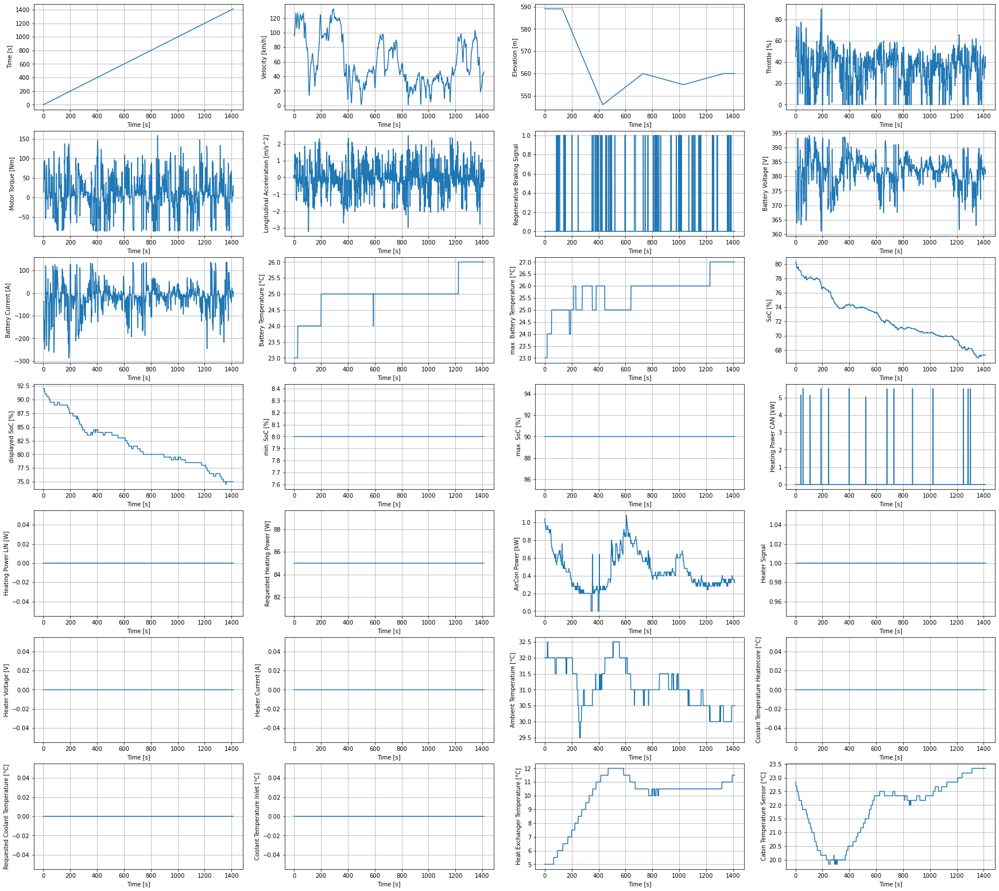

In [10]:
# Bring in a single trip as dataframe
df_trip = pd.read_csv(
    'TripA02.csv',
    sep=';',
    encoding=chardet.detect(open(f'TripA02.csv', 'rb').read())['encoding']
)
# Plot results of a single trips
plot_dataframe_subplots(df_trip, nrows=12, ncols=4, figsize=(30, 48))

In [4]:
df_trip = pd.read_csv(
    'TripA02.csv',
    sep=';',
    encoding=chardet.detect(open(f'TripA02.csv', 'rb').read())['encoding']
)
df_trip.columns

Index(['Time [s]', 'Velocity [km/h]', 'Elevation [m]', 'Throttle [%]',
       'Motor Torque [Nm]', 'Longitudinal Acceleration [m/s^2]',
       'Regenerative Braking Signal ', 'Battery Voltage [V]',
       'Battery Current [A]', 'Battery Temperature [°C]',
       'max. Battery Temperature [°C]', 'SoC [%]', 'displayed SoC [%]',
       'min. SoC [%]', 'max. SoC [%)', 'Heating Power CAN [kW]',
       'Heating Power LIN [W]', 'Requested Heating Power [W]',
       'AirCon Power [kW]', 'Heater Signal', 'Heater Voltage [V]',
       'Heater Current [A]', 'Ambient Temperature [°C]',
       'Coolant Temperature Heatercore [°C]',
       'Requested Coolant Temperature [°C]', 'Coolant Temperature Inlet [°C]',
       'Heat Exchanger Temperature [°C]', 'Cabin Temperature Sensor [°C]'],
      dtype='object')

### Now Plotting the features vs Time for all the files ,to find out some relation

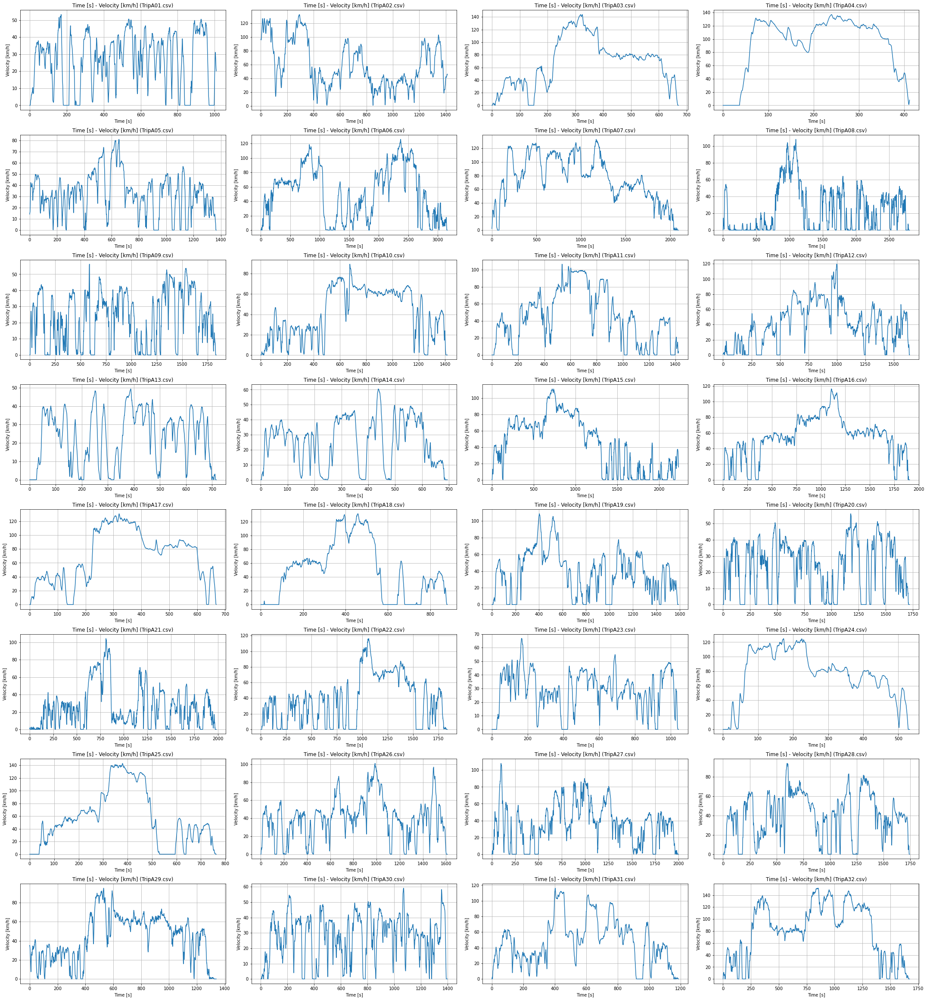

In [21]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[
    "TripA01.csv",
    "TripA02.csv",
    "TripA03.csv",
    "TripA04.csv",
    "TripA05.csv",
    "TripA06.csv",
    "TripA07.csv",
    "TripA08.csv",
    "TripA09.csv",
    "TripA10.csv",
    "TripA11.csv",
    "TripA12.csv",
    "TripA13.csv",
    "TripA14.csv",
    "TripA15.csv",
    "TripA16.csv",
    "TripA17.csv",
    "TripA18.csv",
    "TripA19.csv",
    "TripA20.csv",
    "TripA21.csv",
    "TripA22.csv",
    "TripA23.csv",
    "TripA24.csv",
    "TripA25.csv",
    "TripA26.csv",
    "TripA27.csv",
    "TripA28.csv",
    "TripA29.csv",
    "TripA30.csv",
    "TripA31.csv",
    "TripA32.csv",
]


df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'Velocity [km/h]'

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


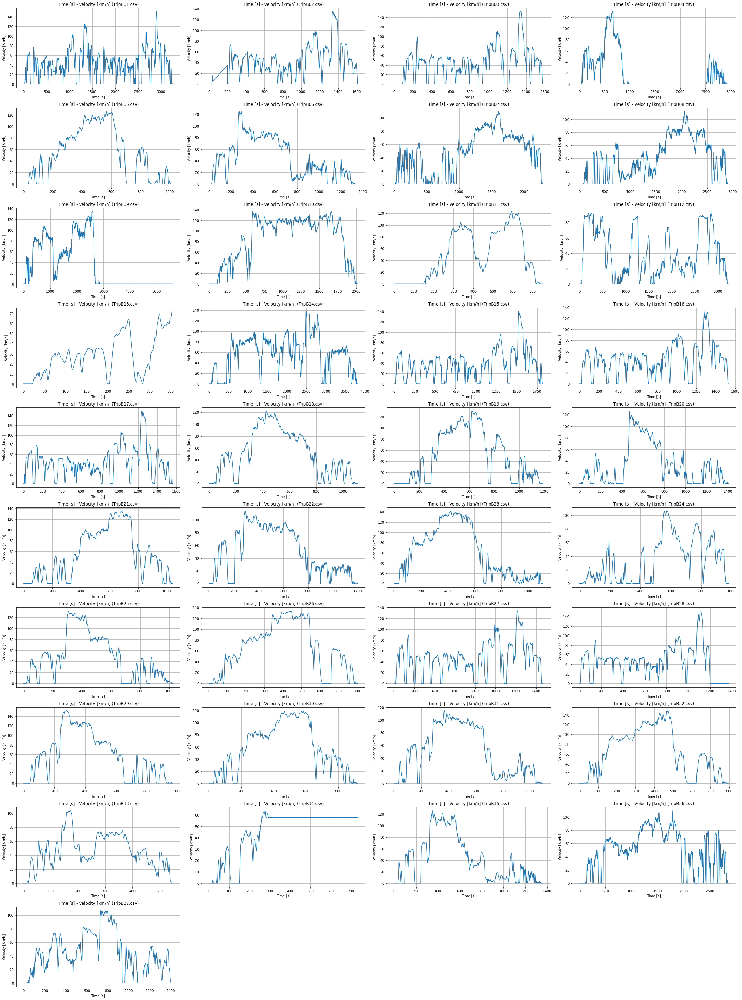

In [73]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[ 
    "TripB01.csv",
    "TripB02.csv",
    "TripB03.csv",
    "TripB04.csv",
    "TripB05.csv",
    "TripB06.csv",
    "TripB07.csv",
    "TripB08.csv",
    "TripB09.csv",
    "TripB10.csv",
    "TripB11.csv",
    "TripB12.csv",
    "TripB13.csv",
    "TripB14.csv",
    "TripB15.csv",
    "TripB16.csv",
    "TripB17.csv",
    "TripB18.csv",
    "TripB19.csv",
    "TripB20.csv",
    "TripB21.csv",
    "TripB22.csv",
    "TripB23.csv",
    "TripB24.csv",
    "TripB25.csv",
    "TripB26.csv",
    "TripB27.csv",
    "TripB28.csv",
    "TripB29.csv",
    "TripB30.csv",
    "TripB31.csv",
    "TripB32.csv",
    "TripB33.csv",
    "TripB34.csv",
    "TripB35.csv",
    "TripB36.csv",
    "TripB37.csv",
]


df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'Velocity [km/h]'

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


In [66]:
import pandas as pd
import chardet
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.applications import MobileNet
# List of dataset files
file_list = [
    "TripA01.csv",
    "TripA02.csv",
    "TripA03.csv",
    "TripA04.csv",
    "TripA05.csv",
    "TripA06.csv",
    "TripA07.csv",
    "TripA08.csv",
    "TripA09.csv",
    "TripA10.csv",
    "TripA11.csv",
    "TripA12.csv",
    "TripA13.csv",
    "TripA14.csv",
    "TripA15.csv",
    "TripA16.csv",
    "TripA17.csv",
    "TripA18.csv",
    "TripA19.csv",
    "TripA20.csv",
    "TripA21.csv",
    "TripA22.csv",
    "TripA23.csv",
    "TripA24.csv",
    "TripA25.csv",
    "TripA26.csv",
    "TripA27.csv",
    "TripA28.csv",
    "TripA29.csv",
    "TripA30.csv",
    "TripA31.csv",
    "TripA32.csv",
    "TripB01.csv",
    "TripB02.csv",
    "TripB03.csv",
    "TripB04.csv",
    "TripB05.csv",
    "TripB06.csv",
    "TripB07.csv",
    "TripB08.csv",
    "TripB09.csv",
    "TripB10.csv",
    "TripB11.csv",
    "TripB12.csv",
    "TripB13.csv",
    "TripB14.csv",
    "TripB15.csv",
    "TripB16.csv",
    "TripB17.csv",
    "TripB18.csv",
    "TripB19.csv",
    "TripB20.csv",
    "TripB21.csv",
    "TripB22.csv",
    "TripB23.csv",
    "TripB24.csv",
    "TripB25.csv",
    "TripB26.csv",
    "TripB27.csv",
    "TripB28.csv",
    "TripB29.csv",
    "TripB30.csv",
    "TripB31.csv",
    "TripB32.csv",
    "TripB33.csv",
    "TripB34.csv",
    "TripB35.csv",
    "TripB36.csv",
    "TripB37.csv"
]


# Create an empty DataFrame to store the results
result_df = pd.DataFrame(columns=['File', 'Velocity_Info'])

# Load the pre-trained LSTM model
base_model = Sequential()
base_model.add(LSTM(16, input_shape=(1, 1), trainable=False))
base_model.add(Dense(1))

# Create a new model for fine-tuning
model = Sequential()
model.add(Dense(32, activation='relu', input_shape=base_model.output_shape[1:]))
model.add(Dense(1))

# Compile the model
model.compile(loss='mean_squared_error', optimizer='adam')

# Process each file
for file in file_list:
    # Read the file into a DataFrame
    df = pd.read_csv(file, sep=';', encoding=chardet.detect(open(file, 'rb').read())['encoding'])

    # Extract the velocity column from the dataset
    velocity = df['Velocity [km/h]']

    # Normalize the velocity values between 0 and 1
    normalized_velocity = (velocity - velocity.min()) / (velocity.max() - velocity.min())

    # Convert the normalized velocity series to a numpy array
    velocity_array = np.array(normalized_velocity)

    # Reshape the velocity array to match the LSTM input shape
    velocity_input = velocity_array.reshape(-1, 1, 1)

    # Use the pre-trained LSTM model as a feature extractor
    features = base_model.predict(velocity_input)

    # Fit the model to the velocity data
    model.fit(features, velocity_array, epochs=3, batch_size=1, verbose=0)

    # Predict the velocity using the trained model
    predicted_features = base_model.predict(velocity_input)
    velocity_predicted = model.predict(predicted_features)

    # Denormalize the predicted velocity values
    velocity_predicted_denormalized = velocity_predicted * (velocity.max() - velocity.min()) + velocity.min()

    # Store the file name and predicted velocity in the result DataFrame
    result_df = result_df.append({'File': file, 'Velocity_Info': velocity_predicted_denormalized.flatten()[-1]}, ignore_index=True)

# Print the result DataFrame
print(result_df)

443/443 [==============================] - 0s 928us/step
           File Velocity_Info
0   TripA01.csv     20.186638
1   TripA02.csv     46.436352
2   TripA03.csv      1.192714
3   TripA04.csv      8.313974
4   TripA05.csv     -0.037039
..          ...           ...
64  TripB33.csv       0.04491
65  TripB34.csv     57.864353
66  TripB35.csv       0.12071
67  TripB36.csv      -0.04262
68  TripB37.csv     -0.046091

[69 rows x 2 columns]


In [67]:
result_df.head()

,File,Velocity_Info
0,TripA01.csv,20.186638
1,TripA02.csv,46.436352
2,TripA03.csv,1.192714
3,TripA04.csv,8.313974
4,TripA05.csv,-0.037039


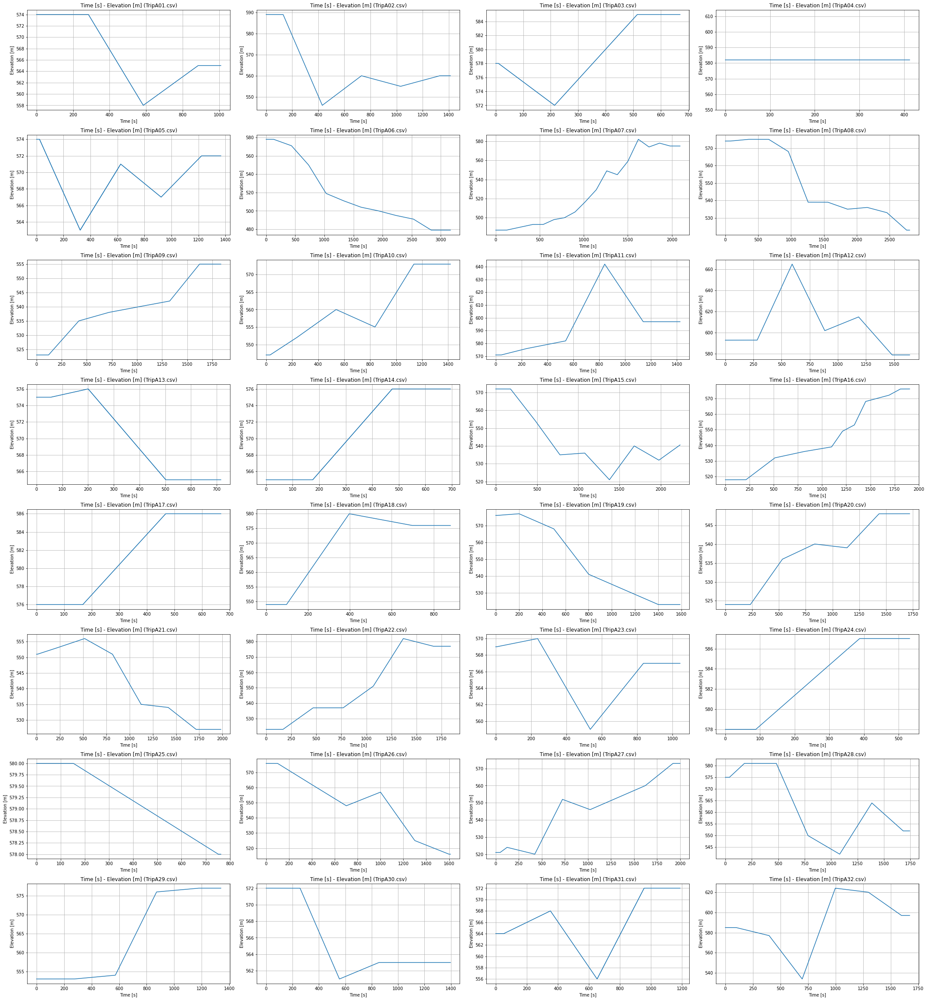

In [24]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[
    "TripA01.csv",
    "TripA02.csv",
    "TripA03.csv",
    "TripA04.csv",
    "TripA05.csv",
    "TripA06.csv",
    "TripA07.csv",
    "TripA08.csv",
    "TripA09.csv",
    "TripA10.csv",
    "TripA11.csv",
    "TripA12.csv",
    "TripA13.csv",
    "TripA14.csv",
    "TripA15.csv",
    "TripA16.csv",
    "TripA17.csv",
    "TripA18.csv",
    "TripA19.csv",
    "TripA20.csv",
    "TripA21.csv",
    "TripA22.csv",
    "TripA23.csv",
    "TripA24.csv",
    "TripA25.csv",
    "TripA26.csv",
    "TripA27.csv",
    "TripA28.csv",
    "TripA29.csv",
    "TripA30.csv",
    "TripA31.csv",
    "TripA32.csv"
    
]


df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'Elevation [m]'

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


In [167]:
# import pandas as pd
# import numpy as np
# import chardet

# def count_peaks(velocity):
#     derivative = np.diff(velocity)
#     num_peaks = 0
    
#     for i in range(1, len(derivative)):
#         if derivative[i-1] > 0 and derivative[i] < 0:
#             num_peaks += 1
    
#     return num_peaks

# # List of dataset files
# file_list = [
#     "TripA01.csv",
#     "TripA02.csv",
#     "TripA03.csv",
#     "TripA04.csv",
#     "TripA05.csv",
#     "TripA06.csv",
#     "TripA07.csv",
#     "TripA08.csv",
#     "TripA09.csv",
#     "TripA10.csv",
#     "TripA11.csv",
#     "TripA12.csv",
#     "TripA13.csv",
#     "TripA14.csv",
#     "TripA15.csv",
#     "TripA16.csv",
#     "TripA17.csv",
#     "TripA18.csv",
#     "TripA19.csv",
#     "TripA20.csv",
#     "TripA21.csv",
#     "TripA22.csv",
#     "TripA23.csv",
#     "TripA24.csv",
#     "TripA25.csv",
#     "TripA26.csv",
#     "TripA27.csv",
#     "TripA28.csv",
#     "TripA29.csv",
#     "TripA30.csv",
#     "TripA31.csv",
#     "TripA32.csv",
#     "TripB01.csv",
#     "TripB02.csv",
#     "TripB03.csv",
#     "TripB04.csv",
#     "TripB05.csv",
#     "TripB06.csv",
#     "TripB07.csv",
#     "TripB08.csv",
#     "TripB09.csv",
#     "TripB10.csv",
#     "TripB11.csv",
#     "TripB12.csv",
#     "TripB13.csv",
#     "TripB14.csv",
#     "TripB15.csv",
#     "TripB16.csv",
#     "TripB17.csv",
#     "TripB18.csv",
#     "TripB19.csv",
#     "TripB20.csv",
#     "TripB21.csv",
#     "TripB22.csv",
#     "TripB23.csv",
#     "TripB24.csv",
#     "TripB25.csv",
#     "TripB26.csv",
#     "TripB27.csv",
#     "TripB28.csv",
#     "TripB29.csv",
#     "TripB30.csv",
#     "TripB31.csv",
#     "TripB32.csv",
#     "TripB33.csv",
#     "TripB34.csv",
#     "TripB35.csv",
#     "TripB36.csv",
#     "TripB37.csv"
# ]

# # Create an empty DataFrame to store the results
# result_df = pd.DataFrame(columns=['File', 'Peaks', 'Rash Driving Order', 'Elevation travelled'])

# # Process each file
# for file in file_list:
#     # Read the file into a DataFrame
#     df = pd.read_csv(file, sep=';', encoding=chardet.detect(open(file, 'rb').read())['encoding'])
    
#     # Calculate the number of peaks for the 'Velocity [km/h]' feature
#     peaks = count_peaks(df['Velocity [km/h]'])
    
#     # Calculate the distance traveled in elevation with positive slope
#     elevation_slope_positive = df.loc[df['Elevation [m]'].diff() > 0, 'Elevation [m]'].sum()
    
#     # Assign rash driving order based on the number of peaks
#     if peaks >= 2000:
#         rash_driving_order = 'First'
#     elif peaks >= 1000:
#         rash_driving_order = 'Second'
#     elif peaks >= 500:
#         rash_driving_order = 'Third'
#     else:
#         rash_driving_order = 'Low Priority'
    
#     # Store the file name, the number of peaks, the rash driving order, and the distance traveled in elevation with positive slope in the result DataFrame
#     result_df = result_df.append({'File': file, 'Peaks': peaks, 'Rash Driving Order': rash_driving_order, 'Elevation travelled': elevation_slope_positive}, ignore_index=True)

# # Print the result DataFrame
# print(result_df)


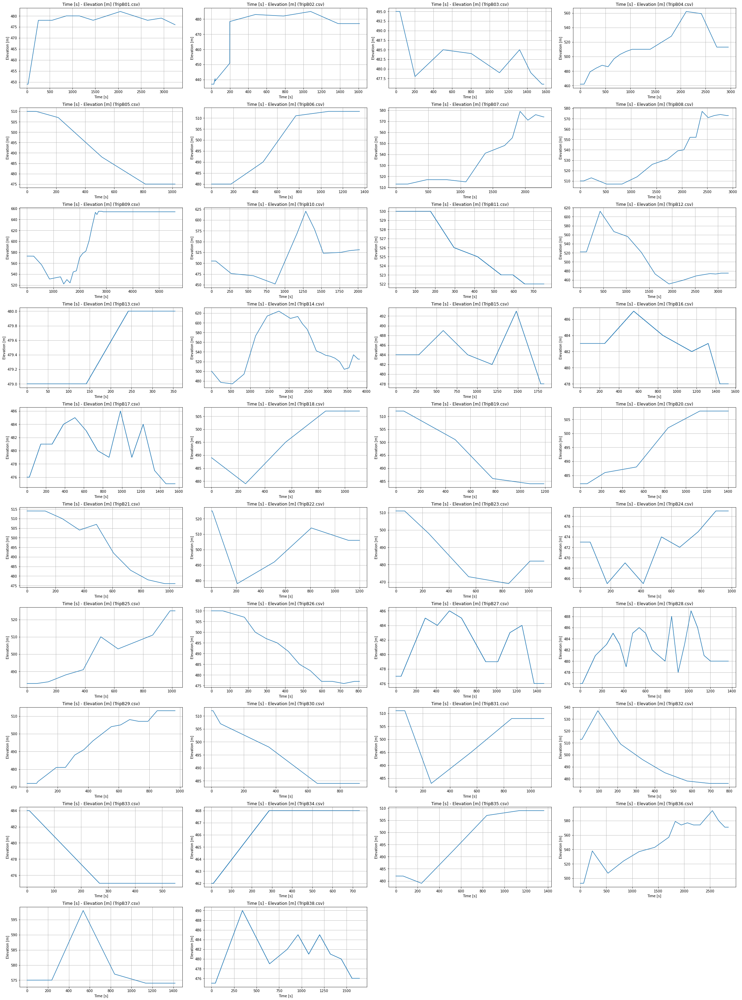

In [42]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[   "TripB01.csv",
    "TripB02.csv",
    "TripB03.csv",
    "TripB04.csv",
    "TripB05.csv",
    "TripB06.csv",
    "TripB07.csv",
    "TripB08.csv",
    "TripB09.csv",
    "TripB10.csv",
    "TripB11.csv",
    "TripB12.csv",
    "TripB13.csv",
    "TripB14.csv",
    "TripB15.csv",
    "TripB16.csv",
    "TripB17.csv",
    "TripB18.csv",
    "TripB19.csv",
    "TripB20.csv",
    "TripB21.csv",
    "TripB22.csv",
    "TripB23.csv",
    "TripB24.csv",
    "TripB25.csv",
    "TripB26.csv",
    "TripB27.csv",
    "TripB28.csv",
    "TripB29.csv",
    "TripB30.csv",
    "TripB31.csv",
    "TripB32.csv",
    "TripB33.csv",
    "TripB34.csv",
    "TripB35.csv",
    "TripB36.csv",
    "TripB37.csv",
    "TripB38.csv"
]

df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'Elevation [m]'

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


In [61]:
import pandas as pd
import numpy as np
import chardet

# List of dataset files
file_list = [
    "TripA01.csv",
    "TripA02.csv",
    "TripA03.csv",
    "TripA04.csv",
    "TripA05.csv",
    "TripA06.csv",
    "TripA07.csv",
    "TripA08.csv",
    "TripA09.csv",
    "TripA10.csv",
    "TripA11.csv",
    "TripA12.csv",
    "TripA13.csv",
    "TripA14.csv",
    "TripA15.csv",
    "TripA16.csv",
    "TripA17.csv",
    "TripA18.csv",
    "TripA19.csv",
    "TripA20.csv",
    "TripA21.csv",
    "TripA22.csv",
    "TripA23.csv",
    "TripA24.csv",
    "TripA25.csv",
    "TripA26.csv",
    "TripA27.csv",
    "TripA28.csv",
    "TripA29.csv",
    "TripA30.csv",
    "TripA31.csv",
    "TripA32.csv",
    "TripB01.csv",
    "TripB02.csv",
    "TripB03.csv",
    "TripB04.csv",
    "TripB05.csv",
    "TripB06.csv",
    "TripB07.csv",
    "TripB08.csv",
    "TripB09.csv",
    "TripB10.csv",
    "TripB11.csv",
    "TripB12.csv",
    "TripB13.csv",
    "TripB14.csv",
    "TripB15.csv",
    "TripB16.csv",
    "TripB17.csv",
    "TripB18.csv",
    "TripB19.csv",
    "TripB20.csv",
    "TripB21.csv",
    "TripB22.csv",
    "TripB23.csv",
    "TripB24.csv",
    "TripB25.csv",
    "TripB26.csv",
    "TripB27.csv",
    "TripB28.csv",
    "TripB29.csv",
    "TripB30.csv",
    "TripB31.csv",
    "TripB32.csv",
    "TripB33.csv",
    "TripB34.csv",
    "TripB35.csv",
    "TripB36.csv",
    "TripB37.csv"
]

# Create an empty DataFrame to store the results
result_df = pd.DataFrame(columns=['File', 'Elevation travelled'])

# Process each file
for file in file_list:
    # Read the file into a DataFrame
    df = pd.read_csv(file, sep=';', encoding=chardet.detect(open(file, 'rb').read())['encoding'])
    
    # Calculate the distance traveled in elevation with positive slope
    elevation_slope_positive = df.loc[df['Elevation [m]'].diff() > 0, 'Elevation [m]'].sum()
    
    # Store the file name and the distance traveled in elevation with positive slope in the result DataFrame
    result_df = result_df.append({'File': file, 'Elevation travelled': elevation_slope_positive}, ignore_index=True)

# Print the result DataFrame
print(result_df)


           File Elevation travelled
0   TripA01.csv            393053.5
1   TripA02.csv           1052959.5
2   TripA03.csv            752056.5
3   TripA04.csv                   0
4   TripA05.csv            738356.5
..          ...                 ...
64  TripB33.csv                 0.0
65  TripB34.csv            279003.0
66  TripB35.csv           1482015.0
67  TripB36.csv          5568640.96
68  TripB37.csv           1348961.5

[69 rows x 2 columns]


In [69]:
df1=pd.read_csv('Final1.csv')
df1.head()

,Unnamed: 0,Trip,Date,Route/Area,Weather,Battery Temperature (Start) [°C],Battery Temperature (End),Battery State of Charge (Start),Battery State of Charge (End),SoC difference,...,Peaks,Rash Driving Order,Elevation travelled,Peak_Torque,Changes in Longitudinal Acceleration [m/s^2],Peaks and Falls in Longitudinal Acceleration [m/s^2],Total Change in Heat Exchanger Temperature [°C],Average Change in AirCon Power [kW],Average Absolute Fluctuations in Battery Voltage [V],Signals in Regenerative Braking Signal
0,0,TripA01,2019-06-25_13-21-14,Munich East,sunny,21.0,22.0,0.863,0.803,0.060,...,572,Third,393053.5,1146.0,9408.0,834.0,-25.5,0.000151,0.108443,1205.0
1,1,TripA02,2019-06-25_14-05-31,Munich East,sunny,23.0,26.0,0.803,0.673,0.130,...,838,Third,1052959.5,1432.0,13596.0,1743.0,6.5,-0.000051,0.190219,1726.0
2,2,TripA03,2019-06-28_10-02-15,Munich East,sunny,24.0,25.0,0.835,0.751,0.084,...,444,Low Priority,752056.5,556.0,6420.0,888.0,-6.5,-0.000042,0.176427,418.0
3,3,TripA04,2019-06-28_10-13-30,Munich East,sunny,25.0,27.0,0.751,0.667,0.084,...,278,Low Priority,0.0,244.0,3952.0,567.0,-4.5,-0.000010,0.188363,186.0
4,4,TripA05,2019-06-28_10-20-26,Munich East,sunny,27.0,27.0,0.667,0.602,0.065,...,961,Third,738356.5,1627.0,12869.0,1430.0,0.0,0.000015,0.095953,1550.0


In [70]:
df1['Elevation travelled']

0      393053.50
1     1052959.50
2      752056.50
3           0.00
4      738356.50
         ...    
64          0.00
65     279003.00
66    1482015.00
67    5568640.96
68    1348961.50
Name: Elevation travelled, Length: 69, dtype: float64

In [71]:
# Assuming df1 is the DataFrame containing the 'Elevation travelled' column

# Rename the 'Elevation travelled' column in df1 to match the desired column name in result_df
df1.rename(columns={'Elevation travelled': 'Elevation_Travelled'}, inplace=True)

# Concatenate result_df and df1 along the column axis
result_df = pd.concat([result_df, df1['Elevation_Travelled']], axis=1)

# Print the updated result DataFrame
print(result_df)


           File Velocity_Info  Elevation_Travelled
0   TripA01.csv     20.186638            393053.50
1   TripA02.csv     46.436352           1052959.50
2   TripA03.csv      1.192714            752056.50
3   TripA04.csv      8.313974                 0.00
4   TripA05.csv     -0.037039            738356.50
..          ...           ...                  ...
64  TripB33.csv       0.04491                 0.00
65  TripB34.csv     57.864353            279003.00
66  TripB35.csv       0.12071           1482015.00
67  TripB36.csv      -0.04262           5568640.96
68  TripB37.csv     -0.046091           1348961.50

[69 rows x 3 columns]


I created a new feature of more distance travelled upward elevation,less the range,also there was similarity between velocity ,throttle and elevation

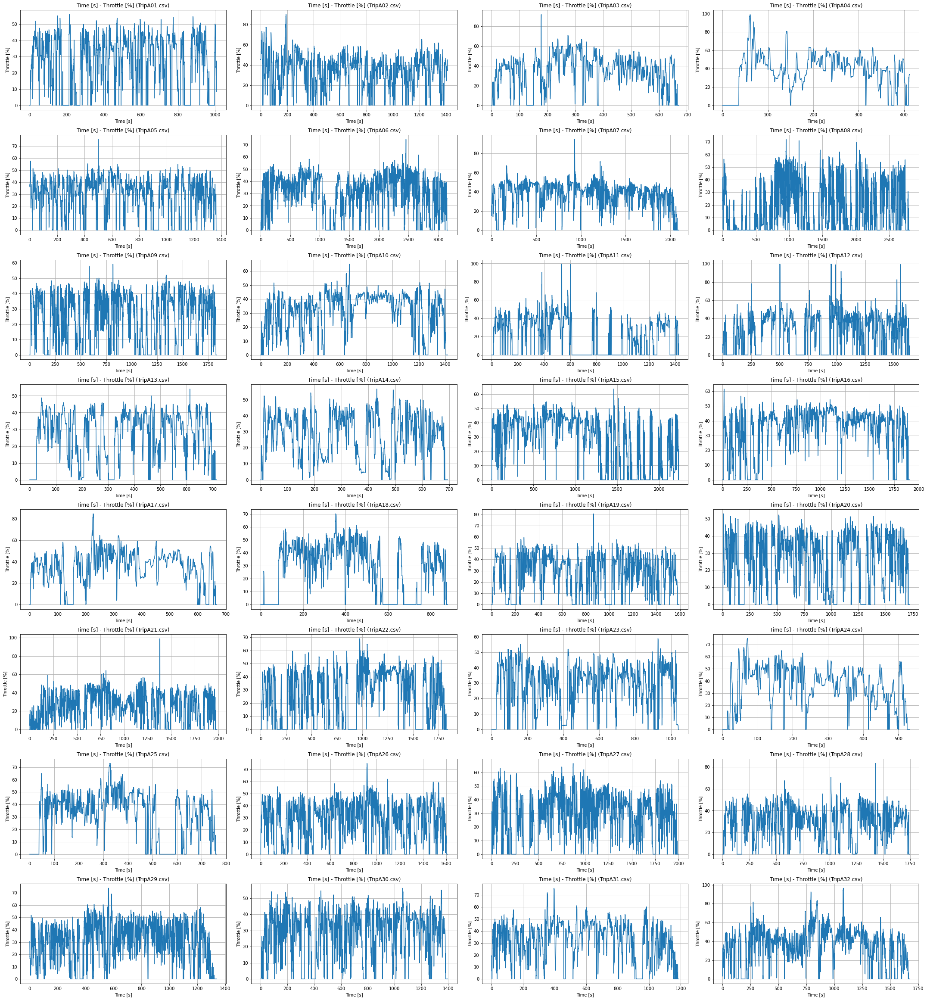

In [25]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[
    "TripA01.csv",
    "TripA02.csv",
    "TripA03.csv",
    "TripA04.csv",
    "TripA05.csv",
    "TripA06.csv",
    "TripA07.csv",
    "TripA08.csv",
    "TripA09.csv",
    "TripA10.csv",
    "TripA11.csv",
    "TripA12.csv",
    "TripA13.csv",
    "TripA14.csv",
    "TripA15.csv",
    "TripA16.csv",
    "TripA17.csv",
    "TripA18.csv",
    "TripA19.csv",
    "TripA20.csv",
    "TripA21.csv",
    "TripA22.csv",
    "TripA23.csv",
    "TripA24.csv",
    "TripA25.csv",
    "TripA26.csv",
    "TripA27.csv",
    "TripA28.csv",
    "TripA29.csv",
    "TripA30.csv",
    "TripA31.csv",
    "TripA32.csv",
]


df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'Throttle [%]'

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


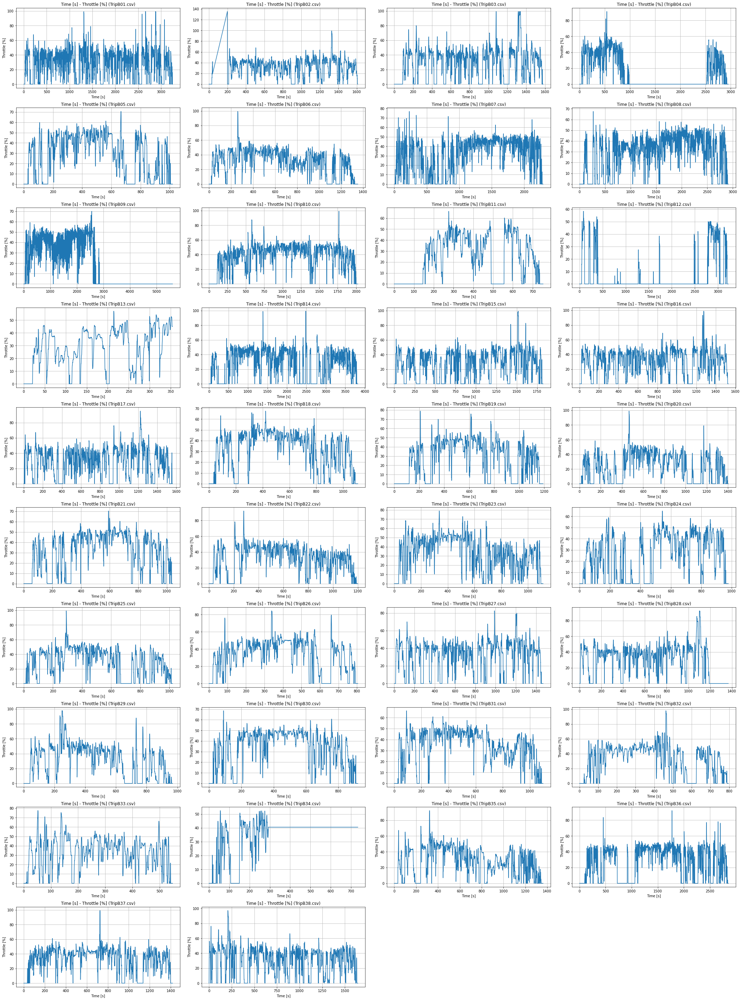

In [43]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[   "TripB01.csv",
    "TripB02.csv",
    "TripB03.csv",
    "TripB04.csv",
    "TripB05.csv",
    "TripB06.csv",
    "TripB07.csv",
    "TripB08.csv",
    "TripB09.csv",
    "TripB10.csv",
    "TripB11.csv",
    "TripB12.csv",
    "TripB13.csv",
    "TripB14.csv",
    "TripB15.csv",
    "TripB16.csv",
    "TripB17.csv",
    "TripB18.csv",
    "TripB19.csv",
    "TripB20.csv",
    "TripB21.csv",
    "TripB22.csv",
    "TripB23.csv",
    "TripB24.csv",
    "TripB25.csv",
    "TripB26.csv",
    "TripB27.csv",
    "TripB28.csv",
    "TripB29.csv",
    "TripB30.csv",
    "TripB31.csv",
    "TripB32.csv",
    "TripB33.csv",
    "TripB34.csv",
    "TripB35.csv",
    "TripB36.csv",
    "TripB37.csv",
    "TripB38.csv"
]


df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'Throttle [%]'

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


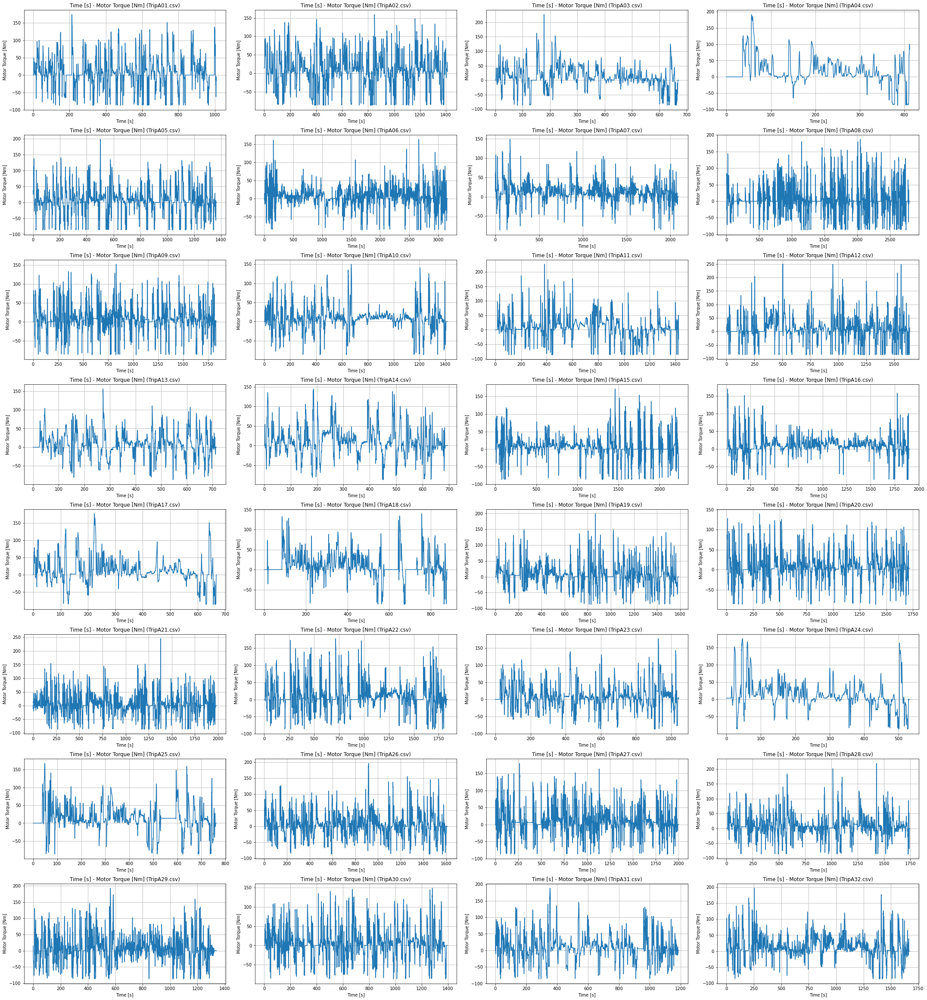

In [26]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[
    "TripA01.csv",
    "TripA02.csv",
    "TripA03.csv",
    "TripA04.csv",
    "TripA05.csv",
    "TripA06.csv",
    "TripA07.csv",
    "TripA08.csv",
    "TripA09.csv",
    "TripA10.csv",
    "TripA11.csv",
    "TripA12.csv",
    "TripA13.csv",
    "TripA14.csv",
    "TripA15.csv",
    "TripA16.csv",
    "TripA17.csv",
    "TripA18.csv",
    "TripA19.csv",
    "TripA20.csv",
    "TripA21.csv",
    "TripA22.csv",
    "TripA23.csv",
    "TripA24.csv",
    "TripA25.csv",
    "TripA26.csv",
    "TripA27.csv",
    "TripA28.csv",
    "TripA29.csv",
    "TripA30.csv",
    "TripA31.csv",
    "TripA32.csv",
]


df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'Motor Torque [Nm]'

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


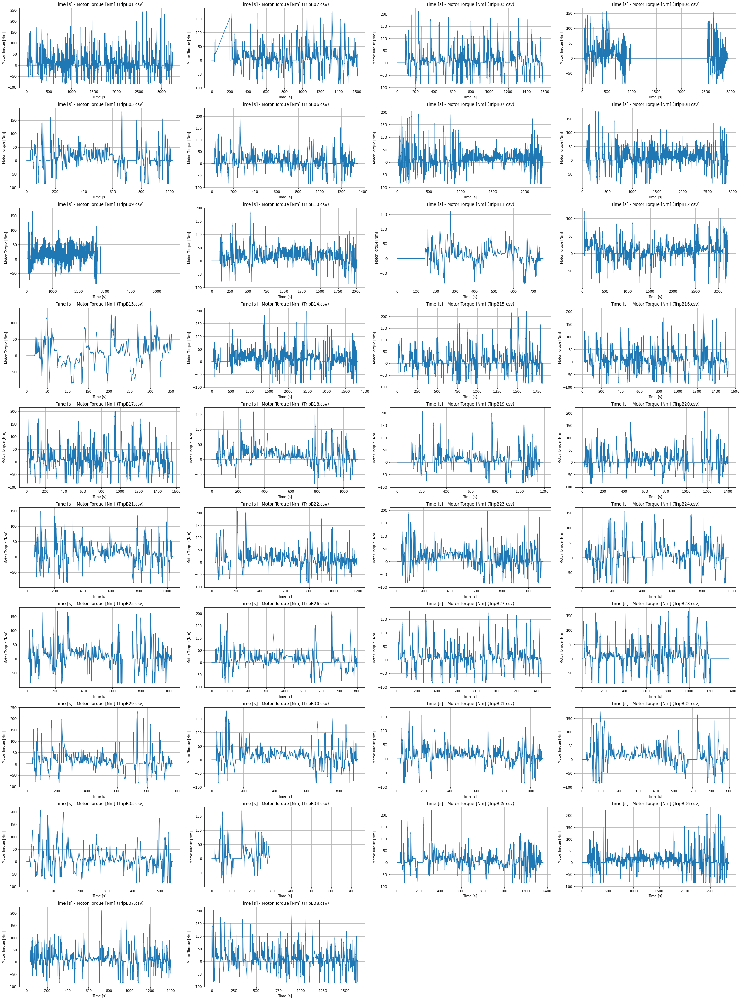

In [44]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[   "TripB01.csv",
    "TripB02.csv",
    "TripB03.csv",
    "TripB04.csv",
    "TripB05.csv",
    "TripB06.csv",
    "TripB07.csv",
    "TripB08.csv",
    "TripB09.csv",
    "TripB10.csv",
    "TripB11.csv",
    "TripB12.csv",
    "TripB13.csv",
    "TripB14.csv",
    "TripB15.csv",
    "TripB16.csv",
    "TripB17.csv",
    "TripB18.csv",
    "TripB19.csv",
    "TripB20.csv",
    "TripB21.csv",
    "TripB22.csv",
    "TripB23.csv",
    "TripB24.csv",
    "TripB25.csv",
    "TripB26.csv",
    "TripB27.csv",
    "TripB28.csv",
    "TripB29.csv",
    "TripB30.csv",
    "TripB31.csv",
    "TripB32.csv",
    "TripB33.csv",
    "TripB34.csv",
    "TripB35.csv",
    "TripB36.csv",
    "TripB37.csv",
    "TripB38.csv"
]


df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'Motor Torque [Nm]'

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


I created a new column of peak torque, that counts no of peak in torque,so that higher the no of peaks,less the range as it is similar to climbing a elevation,it needs to apply higher torque

In [84]:
import pandas as pd
import chardet

def count_peaks(data):
    num_peaks = 0
    
    for i in range(1, len(data)-1):
        if data[i] > data[i-1] and data[i] > data[i+1]:
            num_peaks += 1
    
    return num_peaks

# List of dataset files
file_list = [
    "TripA01.csv",
    "TripA02.csv",
    "TripA03.csv",
    "TripA04.csv",
    "TripA05.csv",
    "TripA06.csv",
    "TripA07.csv",
    "TripA08.csv",
    "TripA09.csv",
    "TripA10.csv",
    "TripA11.csv",
    "TripA12.csv",
    "TripA13.csv",
    "TripA14.csv",
    "TripA15.csv",
    "TripA16.csv",
    "TripA17.csv",
    "TripA18.csv",
    "TripA19.csv",
    "TripA20.csv",
    "TripA21.csv",
    "TripA22.csv",
    "TripA23.csv",
    "TripA24.csv",
    "TripA25.csv",
    "TripA26.csv",
    "TripA27.csv",
    "TripA28.csv",
    "TripA29.csv",
    "TripA30.csv",
    "TripA31.csv",
    "TripA32.csv",
    "TripB01.csv",
    "TripB02.csv",
    "TripB03.csv",
    "TripB04.csv",
    "TripB05.csv",
    "TripB06.csv",
    "TripB07.csv",
    "TripB08.csv",
    "TripB09.csv",
    "TripB10.csv",
    "TripB11.csv",
    "TripB12.csv",
    "TripB13.csv",
    "TripB14.csv",
    "TripB15.csv",
    "TripB16.csv",
    "TripB17.csv",
    "TripB18.csv",
    "TripB19.csv",
    "TripB20.csv",
    "TripB21.csv",
    "TripB22.csv",
    "TripB23.csv",
    "TripB24.csv",
    "TripB25.csv",
    "TripB26.csv",
    "TripB27.csv",
    "TripB28.csv",
    "TripB29.csv",
    "TripB30.csv",
    "TripB31.csv",
    "TripB32.csv",
    "TripB33.csv",
    "TripB34.csv",
    "TripB35.csv",
    "TripB36.csv",
    "TripB37.csv"
]

# Process each file
for file in file_list:
    # Read the file into a DataFrame
    df = pd.read_csv(file, sep=';', encoding=chardet.detect(open(file, 'rb').read())['encoding'])
    
    # Calculate the number of peaks for the 'Motor Torque [Nm]' feature
    peaks = count_peaks(df['Motor Torque [Nm]'])
    
    # Find the row index corresponding to the current file in result_df
    file_index = result_df[result_df['File'] == file].index
    
    # Update the 'Peaks' column with the calculated peaks value
    result_df.loc[file_index, 'Peak_Torque'] = peaks

# Print the updated result DataFrame
print(result_df)


           File Velocity_Info  Elevation_Travelled  \
0   TripA01.csv     20.186638            393053.50   
1   TripA02.csv     46.436352           1052959.50   
2   TripA03.csv      1.192714            752056.50   
3   TripA04.csv      8.313974                 0.00   
4   TripA05.csv     -0.037039            738356.50   
..          ...           ...                  ...   
64  TripB33.csv       0.04491                 0.00   
65  TripB34.csv     57.864353            279003.00   
66  TripB35.csv       0.12071           1482015.00   
67  TripB36.csv      -0.04262           5568640.96   
68  TripB37.csv     -0.046091           1348961.50   

    Signals in Regenerative Braking Signal   Peak_Torque  
0                                    1205.0       1146.0  
1                                    1726.0       1432.0  
2                                     418.0        556.0  
3                                     186.0        244.0  
4                                    1550.0       1627.0

In [88]:
df_overview.head()

,Trip,Date,Route/Area,Weather,Battery Temperature (Start) [°C],Battery Temperature (End),Battery State of Charge (Start),Battery State of Charge (End),SoC difference,Ambient Temperature (Start) [°C],Target Cabin Temperature,Distance [km],Duration [min],Fan,Driving Cycle
0,TripA01,2019-06-25_13-21-14,Munich East,sunny,21.0,22.0,0.863,0.803,0.060,25.5,23.0,7.427690,16.820000,"Automatic, Level 1",1
1,TripA02,2019-06-25_14-05-31,Munich East,sunny,23.0,26.0,0.803,0.673,0.130,32.0,23.0,23.509709,23.550000,"Automatic, Level 1",1
2,TripA03,2019-06-28_10-02-15,Munich East,sunny,24.0,25.0,0.835,0.751,0.084,21.5,27.0,12.820846,11.180000,"Automatic, Level 1",1
3,TripA04,2019-06-28_10-13-30,Munich East,sunny,25.0,27.0,0.751,0.667,0.084,24.0,22.0,10.727491,6.870000,"Automatic, Level 1",1
4,TripA05,2019-06-28_10-20-26,Munich East,sunny,27.0,27.0,0.667,0.602,0.065,24.5,24.0,12.393223,22.776667,"Automatic, Level 1",1


In [89]:
df_overview = df_overview.drop(df_overview.index[-1])

In [92]:
df_overview.columns

Index(['Trip', 'Date', 'Route/Area', 'Weather',
       'Battery Temperature (Start) [°C]', 'Battery Temperature (End)',
       'Battery State of Charge (Start)', 'Battery State of Charge (End)',
       'SoC difference', 'Ambient Temperature (Start) [°C]',
       'Target Cabin Temperature', 'Distance [km]', 'Duration [min]', 'Fan',
       'Driving Cycle'],
      dtype='object')

In [93]:
df_overview=df_overview.drop(columns=['Fan','Weather','Date'],axis=1)

In [95]:
result_df=result_df.drop(columns=['File'])

In [96]:
concatenated_df = pd.concat([result_df, df_overview], axis=1)

In [97]:
concatenated_df.head()

,Velocity_Info,Elevation_Travelled,Signals in Regenerative Braking Signal,Peak_Torque,Trip,Route/Area,Battery Temperature (Start) [°C],Battery Temperature (End),Battery State of Charge (Start),Battery State of Charge (End),SoC difference,Ambient Temperature (Start) [°C],Target Cabin Temperature,Distance [km],Duration [min],Driving Cycle
0,20.186638,393053.5,1205.0,1146.0,TripA01,Munich East,21.0,22.0,0.863,0.803,0.060,25.5,23.0,7.427690,16.820000,1.0
1,46.436352,1052959.5,1726.0,1432.0,TripA02,Munich East,23.0,26.0,0.803,0.673,0.130,32.0,23.0,23.509709,23.550000,1.0
2,1.192714,752056.5,418.0,556.0,TripA03,Munich East,24.0,25.0,0.835,0.751,0.084,21.5,27.0,12.820846,11.180000,1.0
3,8.313974,0.0,186.0,244.0,TripA04,Munich East,25.0,27.0,0.751,0.667,0.084,24.0,22.0,10.727491,6.870000,1.0
4,-0.037039,738356.5,1550.0,1627.0,TripA05,Munich East,27.0,27.0,0.667,0.602,0.065,24.5,24.0,12.393223,22.776667,1.0


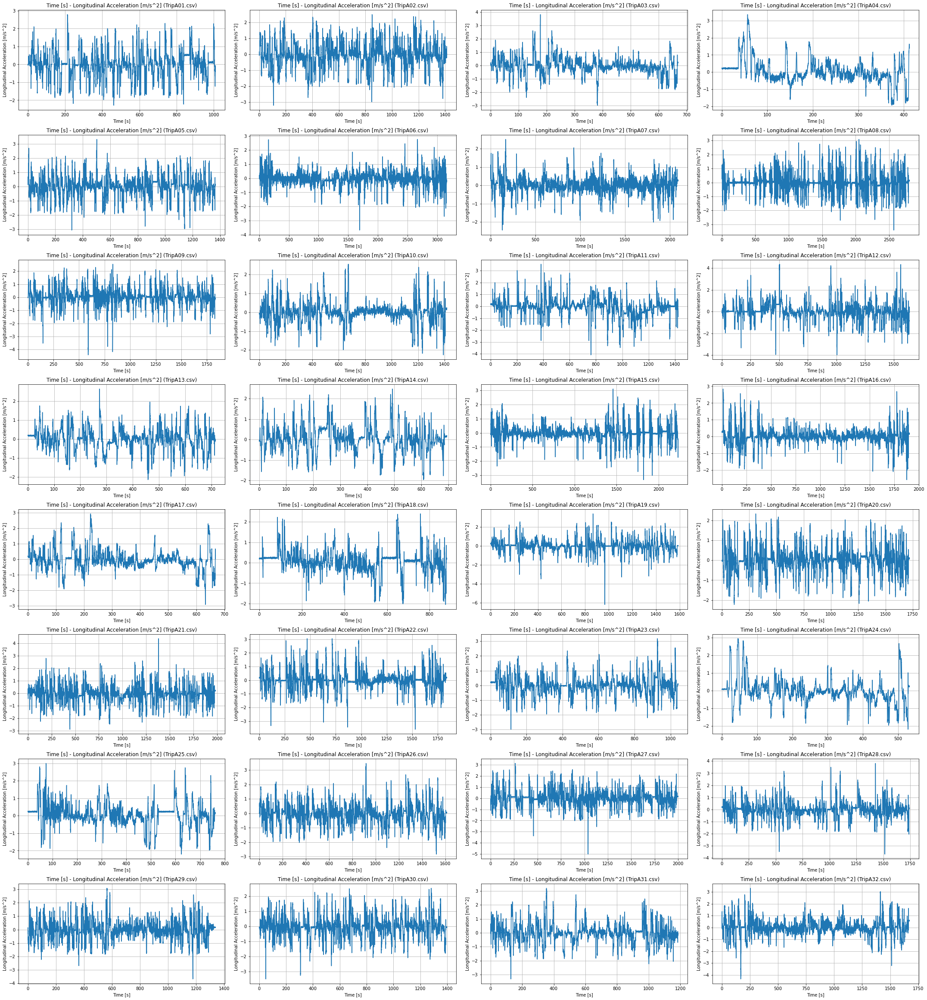

In [32]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[
    "TripA01.csv",
    "TripA02.csv",
    "TripA03.csv",
    "TripA04.csv",
    "TripA05.csv",
    "TripA06.csv",
    "TripA07.csv",
    "TripA08.csv",
    "TripA09.csv",
    "TripA10.csv",
    "TripA11.csv",
    "TripA12.csv",
    "TripA13.csv",
    "TripA14.csv",
    "TripA15.csv",
    "TripA16.csv",
    "TripA17.csv",
    "TripA18.csv",
    "TripA19.csv",
    "TripA20.csv",
    "TripA21.csv",
    "TripA22.csv",
    "TripA23.csv",
    "TripA24.csv",
    "TripA25.csv",
    "TripA26.csv",
    "TripA27.csv",
    "TripA28.csv",
    "TripA29.csv",
    "TripA30.csv",
    "TripA31.csv",
    "TripA32.csv",
]


df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'Longitudinal Acceleration [m/s^2]'

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


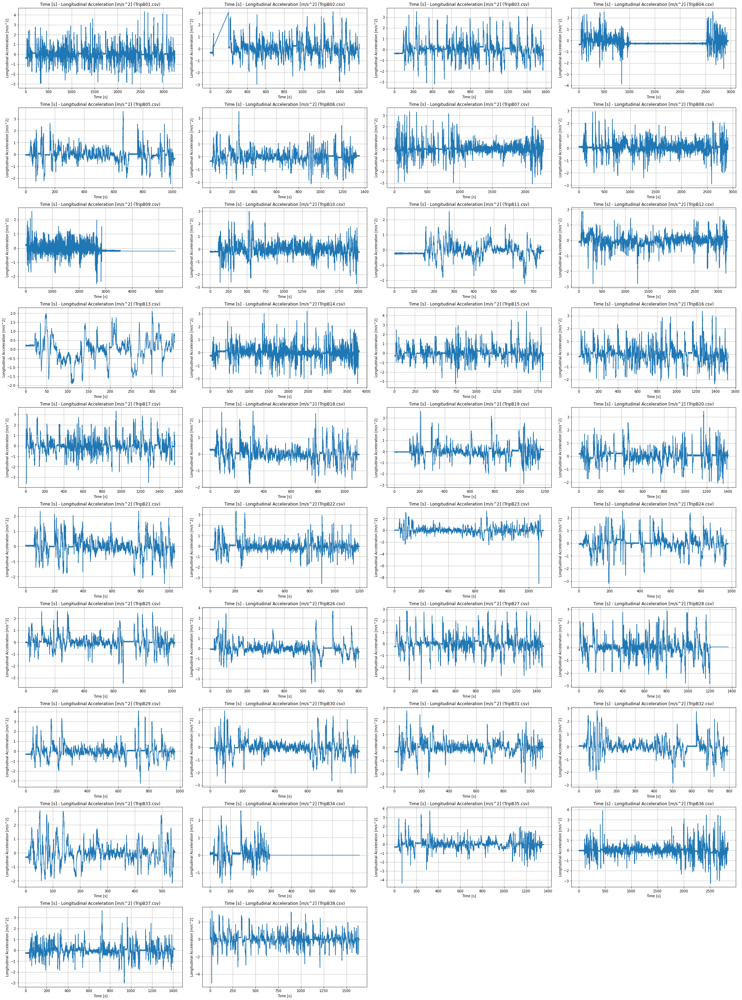

In [45]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[   "TripB01.csv",
    "TripB02.csv",
    "TripB03.csv",
    "TripB04.csv",
    "TripB05.csv",
    "TripB06.csv",
    "TripB07.csv",
    "TripB08.csv",
    "TripB09.csv",
    "TripB10.csv",
    "TripB11.csv",
    "TripB12.csv",
    "TripB13.csv",
    "TripB14.csv",
    "TripB15.csv",
    "TripB16.csv",
    "TripB17.csv",
    "TripB18.csv",
    "TripB19.csv",
    "TripB20.csv",
    "TripB21.csv",
    "TripB22.csv",
    "TripB23.csv",
    "TripB24.csv",
    "TripB25.csv",
    "TripB26.csv",
    "TripB27.csv",
    "TripB28.csv",
    "TripB29.csv",
    "TripB30.csv",
    "TripB31.csv",
    "TripB32.csv",
    "TripB33.csv",
    "TripB34.csv",
    "TripB35.csv",
    "TripB36.csv",
    "TripB37.csv",
    "TripB38.csv"
]

df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'Longitudinal Acceleration [m/s^2]'

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


I created a new feature 'Peaks and Falls in Longitudinal Accelaration',that calculates the no times there is change in velocity wrt to time

In [168]:
# import pandas as pd
# import chardet

# def count_peaks_and_falls(data):
#     num_peaks_falls = 0
    
#     for i in range(1, len(data) - 1):
#         if data[i] > data[i-1] and data[i] > data[i+1] and data[i-1] > data[i+1]:
#             num_peaks_falls += 1
    
#     return num_peaks_falls

# # Specify the feature/column to calculate peaks and falls
# feature = 'Longitudinal Acceleration [m/s^2]'

# # List of dataset files
# file_list =[
#     "TripA01.csv",
#     "TripA02.csv",
#     "TripA03.csv",
#     "TripA04.csv",
#     "TripA05.csv",
#     "TripA06.csv",
#     "TripA07.csv",
#     "TripA08.csv",
#     "TripA09.csv",
#     "TripA10.csv",
#     "TripA11.csv",
#     "TripA12.csv",
#     "TripA13.csv",
#     "TripA14.csv",
#     "TripA15.csv",
#     "TripA16.csv",
#     "TripA17.csv",
#     "TripA18.csv",
#     "TripA19.csv",
#     "TripA20.csv",
#     "TripA21.csv",
#     "TripA22.csv",
#     "TripA23.csv",
#     "TripA24.csv",
#     "TripA25.csv",
#     "TripA26.csv",
#     "TripA27.csv",
#     "TripA28.csv",
#     "TripA29.csv",
#     "TripA30.csv",
#     "TripA31.csv",
#     "TripA32.csv",
#     "TripB01.csv",
#     "TripB02.csv",
#     "TripB03.csv",
#     "TripB04.csv",
#     "TripB05.csv",
#     "TripB06.csv",
#     "TripB07.csv",
#     "TripB08.csv",
#     "TripB09.csv",
#     "TripB10.csv",
#     "TripB11.csv",
#     "TripB12.csv",
#     "TripB13.csv",
#     "TripB14.csv",
#     "TripB15.csv",
#     "TripB16.csv",
#     "TripB17.csv",
#     "TripB18.csv",
#     "TripB19.csv",
#     "TripB20.csv",
#     "TripB21.csv",
#     "TripB22.csv",
#     "TripB23.csv",
#     "TripB24.csv",
#     "TripB25.csv",
#     "TripB26.csv",
#     "TripB27.csv",
#     "TripB28.csv",
#     "TripB29.csv",
#     "TripB30.csv",
#     "TripB31.csv",
#     "TripB32.csv",
#     "TripB33.csv",
#     "TripB34.csv",
#     "TripB35.csv",
#     "TripB36.csv",
#     "TripB37.csv"
# ]

# # Process each file
# for file in file_list:
#     # Read the file into a DataFrame
#     df = pd.read_csv(file, sep=';', encoding=chardet.detect(open(file, 'rb').read())['encoding'])
    
#     # Calculate the number of peaks and falls for the specified feature
#     peaks_falls = count_peaks_and_falls(df[feature])
    
#     # Update the corresponding row in the result_df DataFrame
#     result_df.loc[result_df['File'] == file, 'Peaks and Falls in ' + feature] = peaks_falls

# # Print the updated result_df DataFrame
# print(result_df)


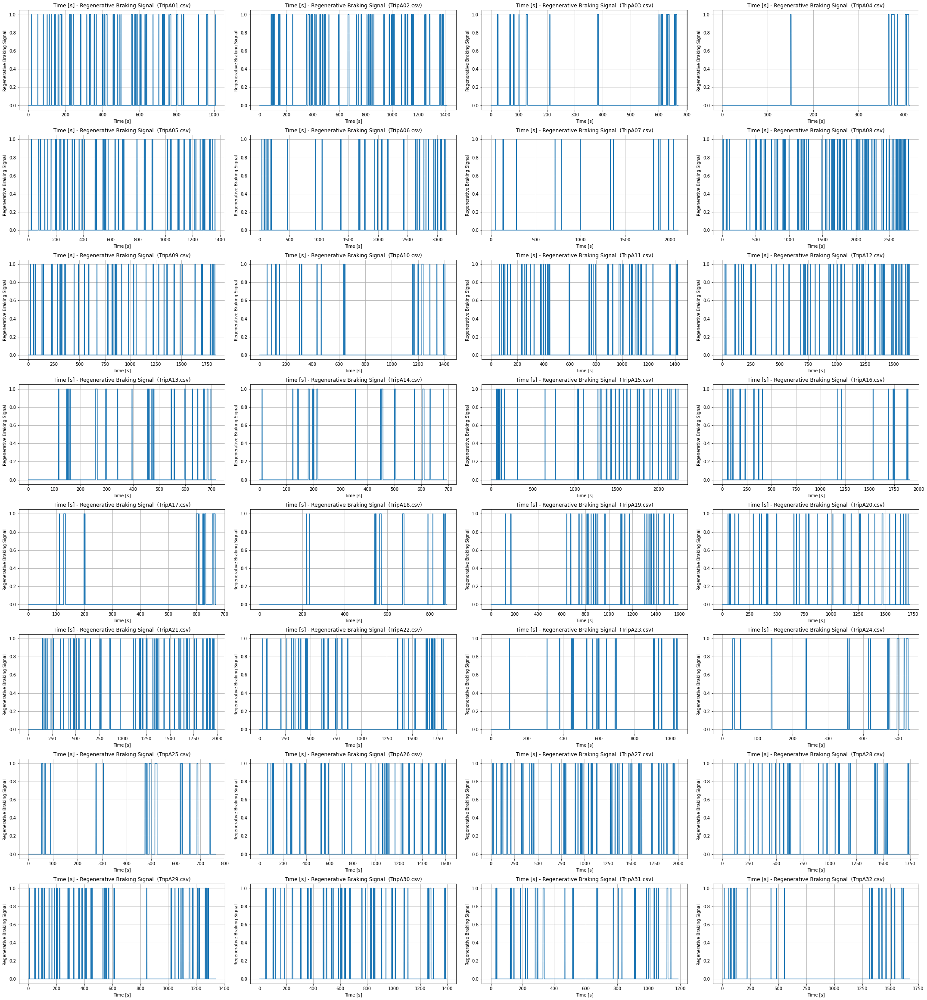

In [33]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[
    "TripA01.csv",
    "TripA02.csv",
    "TripA03.csv",
    "TripA04.csv",
    "TripA05.csv",
    "TripA06.csv",
    "TripA07.csv",
    "TripA08.csv",
    "TripA09.csv",
    "TripA10.csv",
    "TripA11.csv",
    "TripA12.csv",
    "TripA13.csv",
    "TripA14.csv",
    "TripA15.csv",
    "TripA16.csv",
    "TripA17.csv",
    "TripA18.csv",
    "TripA19.csv",
    "TripA20.csv",
    "TripA21.csv",
    "TripA22.csv",
    "TripA23.csv",
    "TripA24.csv",
    "TripA25.csv",
    "TripA26.csv",
    "TripA27.csv",
    "TripA28.csv",
    "TripA29.csv",
    "TripA30.csv",
    "TripA31.csv",
    "TripA32.csv",
]


df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'Regenerative Braking Signal '

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


In [113]:
result_df.columns

Index(['Trip', 'Peaks', 'Rash Driving Order', 'Elevation travelled',
       'Peak_Torque', 'Changes in Longitudinal Acceleration [m/s^2]',
       'Peaks and Falls in Longitudinal Acceleration [m/s^2]',
       'Total Change in Heat Exchanger Temperature [°C]',
       'Average Change in AirCon Power [kW]',
       'Average Absolute Fluctuations in Battery Voltage [V]',
       'Peaks in Regenerative Braking Signal '],
      dtype='object')

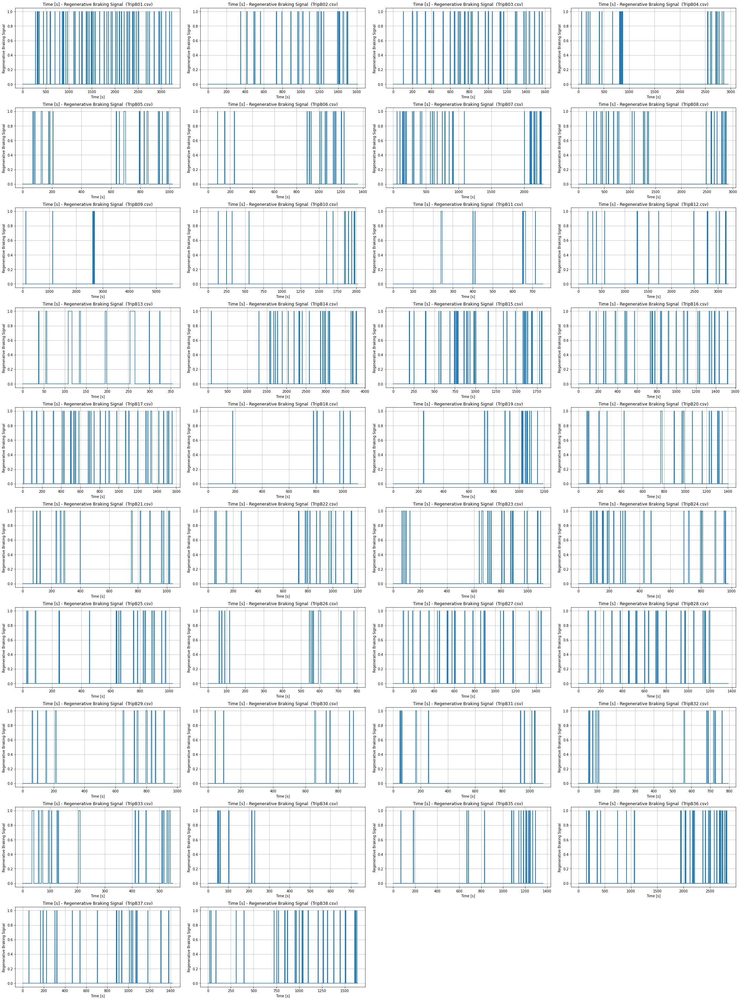

In [46]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[   "TripB01.csv",
    "TripB02.csv",
    "TripB03.csv",
    "TripB04.csv",
    "TripB05.csv",
    "TripB06.csv",
    "TripB07.csv",
    "TripB08.csv",
    "TripB09.csv",
    "TripB10.csv",
    "TripB11.csv",
    "TripB12.csv",
    "TripB13.csv",
    "TripB14.csv",
    "TripB15.csv",
    "TripB16.csv",
    "TripB17.csv",
    "TripB18.csv",
    "TripB19.csv",
    "TripB20.csv",
    "TripB21.csv",
    "TripB22.csv",
    "TripB23.csv",
    "TripB24.csv",
    "TripB25.csv",
    "TripB26.csv",
    "TripB27.csv",
    "TripB28.csv",
    "TripB29.csv",
    "TripB30.csv",
    "TripB31.csv",
    "TripB32.csv",
    "TripB33.csv",
    "TripB34.csv",
    "TripB35.csv",
    "TripB36.csv",
    "TripB37.csv",
    "TripB38.csv"
]


df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'Regenerative Braking Signal '

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


In [78]:
import pandas as pd
import chardet

def calculate_regenerative_braking_feature(data):
    # Calculate the cumulative duration of regenerative braking events
    cumulative_duration = (data * df['Time [s]']).cumsum()
    
    # Calculate the average duration per signal
    avg_duration = cumulative_duration / (data.cumsum() + 1)
    
    # Calculate the average duration change rate
    avg_duration_rate = avg_duration.diff()
    
    # Calculate the feature for regenerative braking
    feature = avg_duration_rate * df['Motor Torque [Nm]']
    
    return feature

# Specify the feature/column to calculate the regenerative braking feature
feature = 'Regenerative Braking Signal '

# List of dataset files
file_list =[
    "TripA01.csv",
    "TripA02.csv",
    "TripA03.csv",
    "TripA04.csv",
    "TripA05.csv",
    "TripA06.csv",
    "TripA07.csv",
    "TripA08.csv",
    "TripA09.csv",
    "TripA10.csv",
    "TripA11.csv",
    "TripA12.csv",
    "TripA13.csv",
    "TripA14.csv",
    "TripA15.csv",
    "TripA16.csv",
    "TripA17.csv",
    "TripA18.csv",
    "TripA19.csv",
    "TripA20.csv",
    "TripA21.csv",
    "TripA22.csv",
    "TripA23.csv",
    "TripA24.csv",
    "TripA25.csv",
    "TripA26.csv",
    "TripA27.csv",
    "TripA28.csv",
    "TripA29.csv",
    "TripA30.csv",
    "TripA31.csv",
    "TripA32.csv",
    "TripB01.csv",
    "TripB02.csv",
    "TripB03.csv",
    "TripB04.csv",
    "TripB05.csv",
    "TripB06.csv",
    "TripB07.csv",
    "TripB08.csv",
    "TripB09.csv",
    "TripB10.csv",
    "TripB11.csv",
    "TripB12.csv",
    "TripB13.csv",
    "TripB14.csv",
    "TripB15.csv",
    "TripB16.csv",
    "TripB17.csv",
    "TripB18.csv",
    "TripB19.csv",
    "TripB20.csv",
    "TripB21.csv",
    "TripB22.csv",
    "TripB23.csv",
    "TripB24.csv",
    "TripB25.csv",
    "TripB26.csv",
    "TripB27.csv",
    "TripB28.csv",
    "TripB29.csv",
    "TripB30.csv",
    "TripB31.csv",
    "TripB32.csv",
    "TripB33.csv",
    "TripB34.csv",
    "TripB35.csv",
    "TripB36.csv",
    "TripB37.csv"
]

# Process each file
for file in file_list:
    # Read the file into a DataFrame
    df = pd.read_csv(file, sep=';', encoding=chardet.detect(open(file, 'rb').read())['encoding'])
    
    # Calculate the regenerative braking feature for the specified feature
    regenerative_braking_feature = calculate_regenerative_braking_feature(df[feature])
    
    # Update the 'Regenerative Braking Signal ' column in the result_df DataFrame
    result_df.loc[result_df['File'] == file, 'Regenerative Braking Signal '] = regenerative_braking_feature.iloc[-1]

# Print the updated result_df DataFrame
print(result_df)

           File Velocity_Info  Elevation_Travelled  \
0   TripA01.csv     20.186638            393053.50   
1   TripA02.csv     46.436352           1052959.50   
2   TripA03.csv      1.192714            752056.50   
3   TripA04.csv      8.313974                 0.00   
4   TripA05.csv     -0.037039            738356.50   
..          ...           ...                  ...   
64  TripB33.csv       0.04491                 0.00   
65  TripB34.csv     57.864353            279003.00   
66  TripB35.csv       0.12071           1482015.00   
67  TripB36.csv      -0.04262           5568640.96   
68  TripB37.csv     -0.046091           1348961.50   

    Regenerative Braking Signal   
0                           -0.0  
1                            0.0  
2                            0.0  
3                            0.0  
4                            0.0  
..                           ...  
64                           0.0  
65                           0.0  
66                           0.0  
6

In [83]:
# Assuming df1 is the DataFrame containing the 'Elevation travelled' column

# Rename the 'Elevation travelled' column in df1 to match the desired column name in result_df
df1.rename(columns={'Signals in Regenerative Braking Signal ': 'Signals in Regenerative Braking Signal '}, inplace=True)

# Concatenate result_df and df1 along the column axis
result_df = pd.concat([result_df, df1['Signals in Regenerative Braking Signal ']], axis=1)

# Print the updated result DataFrame
print(result_df)


           File Velocity_Info  Elevation_Travelled  \
0   TripA01.csv     20.186638            393053.50   
1   TripA02.csv     46.436352           1052959.50   
2   TripA03.csv      1.192714            752056.50   
3   TripA04.csv      8.313974                 0.00   
4   TripA05.csv     -0.037039            738356.50   
..          ...           ...                  ...   
64  TripB33.csv       0.04491                 0.00   
65  TripB34.csv     57.864353            279003.00   
66  TripB35.csv       0.12071           1482015.00   
67  TripB36.csv      -0.04262           5568640.96   
68  TripB37.csv     -0.046091           1348961.50   

    Signals in Regenerative Braking Signal   
0                                    1205.0  
1                                    1726.0  
2                                     418.0  
3                                     186.0  
4                                    1550.0  
..                                      ...  
64                           

In [86]:
result_df.columns

Index(['File', 'Velocity_Info', 'Elevation_Travelled',
       'Signals in Regenerative Braking Signal ', 'Peak_Torque'],
      dtype='object')

In [85]:
df1.columns

Index(['Unnamed: 0', 'Trip', 'Date', 'Route/Area', 'Weather',
       'Battery Temperature (Start) [°C]', 'Battery Temperature (End)',
       'Battery State of Charge (Start)', 'Battery State of Charge (End)',
       'SoC difference', 'Ambient Temperature (Start) [°C]',
       'Target Cabin Temperature', 'Distance [km]', 'Duration [min]', 'Fan',
       'Peaks', 'Rash Driving Order', 'Elevation_Travelled', 'Peak_Torque',
       'Changes in Longitudinal Acceleration [m/s^2]',
       'Peaks and Falls in Longitudinal Acceleration [m/s^2]',
       'Total Change in Heat Exchanger Temperature [°C]',
       'Average Change in AirCon Power [kW]',
       'Average Absolute Fluctuations in Battery Voltage [V]',
       'Signals in Regenerative Braking Signal '],
      dtype='object')

In [ ]:
df

I created a new feature called 'Regenerative Braking Signal',that counts no times brakes applied,it was seen that when vehicle was going downhill only it was occuring ,causing charging of battery

In [166]:
# def count_signals(data):
#     num_signals = (data > 0).sum()
#     return num_signals

# # Specify the feature/column to count signals
# feature = 'Regenerative Braking Signal '
# # List of dataset files
# file_list =[
#     "TripA01.csv",
#     "TripA02.csv",
#     "TripA03.csv",
#     "TripA04.csv",
#     "TripA05.csv",
#     "TripA06.csv",
#     "TripA07.csv",
#     "TripA08.csv",
#     "TripA09.csv",
#     "TripA10.csv",
#     "TripA11.csv",
#     "TripA12.csv",
#     "TripA13.csv",
#     "TripA14.csv",
#     "TripA15.csv",
#     "TripA16.csv",
#     "TripA17.csv",
#     "TripA18.csv",
#     "TripA19.csv",
#     "TripA20.csv",
#     "TripA21.csv",
#     "TripA22.csv",
#     "TripA23.csv",
#     "TripA24.csv",
#     "TripA25.csv",
#     "TripA26.csv",
#     "TripA27.csv",
#     "TripA28.csv",
#     "TripA29.csv",
#     "TripA30.csv",
#     "TripA31.csv",
#     "TripA32.csv",
#     "TripB01.csv",
#     "TripB02.csv",
#     "TripB03.csv",
#     "TripB04.csv",
#     "TripB05.csv",
#     "TripB06.csv",
#     "TripB07.csv",
#     "TripB08.csv",
#     "TripB09.csv",
#     "TripB10.csv",
#     "TripB11.csv",
#     "TripB12.csv",
#     "TripB13.csv",
#     "TripB14.csv",
#     "TripB15.csv",
#     "TripB16.csv",
#     "TripB17.csv",
#     "TripB18.csv",
#     "TripB19.csv",
#     "TripB20.csv",
#     "TripB21.csv",
#     "TripB22.csv",
#     "TripB23.csv",
#     "TripB24.csv",
#     "TripB25.csv",
#     "TripB26.csv",
#     "TripB27.csv",
#     "TripB28.csv",
#     "TripB29.csv",
#     "TripB30.csv",
#     "TripB31.csv",
#     "TripB32.csv",
#     "TripB33.csv",
#     "TripB34.csv",
#     "TripB35.csv",
#     "TripB36.csv",
#     "TripB37.csv"
# ]
# # Process each file
# for file in file_list:
#     # Read the file into a DataFrame
#     df = pd.read_csv(file, sep=';', encoding=chardet.detect(open(file, 'rb').read())['encoding'])
    
#     # Calculate the useful feature for the specified feature
#     useful_feature = calculate_useful_feature(df[feature])
    
#     # Update the corresponding row in the result_df DataFrame
#     result_df.loc[result_df['File'] == file, 'Useful Feature for ' + feature] = useful_feature.iloc[-1]

# # Print the updated result_df DataFrame
# print(result_df)


In [165]:
# import pandas as pd
# import chardet

# def count_signals(data):
#     num_signals = (data > 0).sum()
#     return num_signals

# # Specify the feature/column to count signals
# feature = 'Regenerative Braking Signal'

# # List of dataset files
# file_list = [
#     "TripA01.csv",
#     "TripA02.csv",
#     "TripA03.csv",
#     "TripA04.csv",
#     "TripA05.csv",
#     "TripA06.csv",
#     "TripA07.csv",
#     "TripA08.csv",
#     "TripA09.csv",
#     "TripA10.csv",
#     "TripA11.csv",
#     "TripA12.csv",
#     "TripA13.csv",
#     "TripA14.csv",
#     "TripA15.csv",
#     "TripA16.csv",
#     "TripA17.csv",
#     "TripA18.csv",
#     "TripA19.csv",
#     "TripA20.csv",
#     "TripA21.csv",
#     "TripA22.csv",
#     "TripA23.csv",
#     "TripA24.csv",
#     "TripA25.csv",
#     "TripA26.csv",
#     "TripA27.csv",
#     "TripA28.csv",
#     "TripA29.csv",
#     "TripA30.csv",
#     "TripA31.csv",
#     "TripA32.csv",
#     "TripB01.csv",
#     "TripB02.csv",
#     "TripB03.csv",
#     "TripB04.csv",
#     "TripB05.csv",
#     "TripB06.csv",
#     "TripB07.csv",
#     "TripB08.csv",
#     "TripB09.csv",
#     "TripB10.csv",
#     "TripB11.csv",
#     "TripB12.csv",
#     "TripB13.csv",
#     "TripB14.csv",
#     "TripB15.csv",
#     "TripB16.csv",
#     "TripB17.csv",
#     "TripB18.csv",
#     "TripB19.csv",
#     "TripB20.csv",
#     "TripB21.csv",
#     "TripB22.csv",
#     "TripB23.csv",
#     "TripB24.csv",
#     "TripB25.csv",
#     "TripB26.csv",
#     "TripB27.csv",
#     "TripB28.csv",
#     "TripB29.csv",
#     "TripB30.csv",
#     "TripB31.csv",
#     "TripB32.csv",
#     "TripB33.csv",
#     "TripB34.csv",
#     "TripB35.csv",
#     "TripB36.csv",
#     "TripB37.csv"
# ]

# # Process each file
# for file in file_list:
#     # Read the file into a DataFrame
#     df = pd.read_csv(file, sep=';', encoding=chardet.detect(open(file, 'rb').read())['encoding'])
    
#     # Count the number of signals for the specified feature
#     signals_count = count_signals(df[feature])
    
#     # Update the corresponding row in the result_df DataFrame
#     result_df.loc[result_df['Trip'] == file, 'Regenerative Signals'] = signals_count

# # Print the updated result_df DataFrame
# print(result_df)


In [72]:
result_df

,File,Peaks,Rash Driving Order,Elevation travelled,Peak_Torque,Changes in Longitudinal Acceleration [m/s^2],Peaks and Falls in Longitudinal Acceleration [m/s^2]
0,TripA01.csv,572,Third,393053.5,1146.0,9408.0,834.0
1,TripA02.csv,838,Third,1052959.5,1432.0,13596.0,1743.0
2,TripA03.csv,444,Low Priority,752056.5,556.0,6420.0,888.0
3,TripA04.csv,278,Low Priority,0,244.0,3952.0,567.0
4,TripA05.csv,961,Third,738356.5,1627.0,12869.0,1430.0
...,...,...,...,...,...,...,...
64,TripB33.csv,408,Low Priority,0.0,721.0,5227.0,596.0
65,TripB34.csv,167,Low Priority,279003.0,318.0,2672.0,341.0
66,TripB35.csv,795,Third,1482015.0,1451.0,12576.0,1316.0
67,TripB36.csv,2201,First,5568640.96,3276.0,26252.0,2930.0


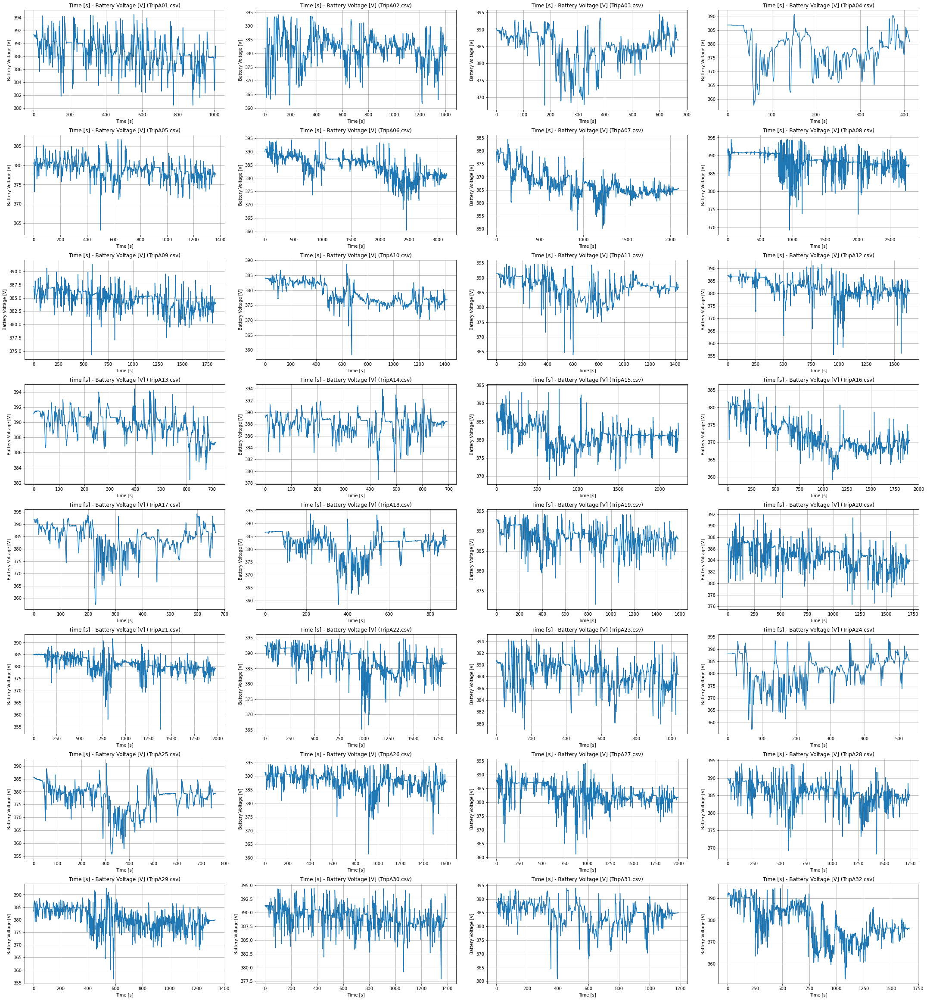

In [34]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[
    "TripA01.csv",
    "TripA02.csv",
    "TripA03.csv",
    "TripA04.csv",
    "TripA05.csv",
    "TripA06.csv",
    "TripA07.csv",
    "TripA08.csv",
    "TripA09.csv",
    "TripA10.csv",
    "TripA11.csv",
    "TripA12.csv",
    "TripA13.csv",
    "TripA14.csv",
    "TripA15.csv",
    "TripA16.csv",
    "TripA17.csv",
    "TripA18.csv",
    "TripA19.csv",
    "TripA20.csv",
    "TripA21.csv",
    "TripA22.csv",
    "TripA23.csv",
    "TripA24.csv",
    "TripA25.csv",
    "TripA26.csv",
    "TripA27.csv",
    "TripA28.csv",
    "TripA29.csv",
    "TripA30.csv",
    "TripA31.csv",
    "TripA32.csv",
]


df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'Battery Voltage [V]'

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


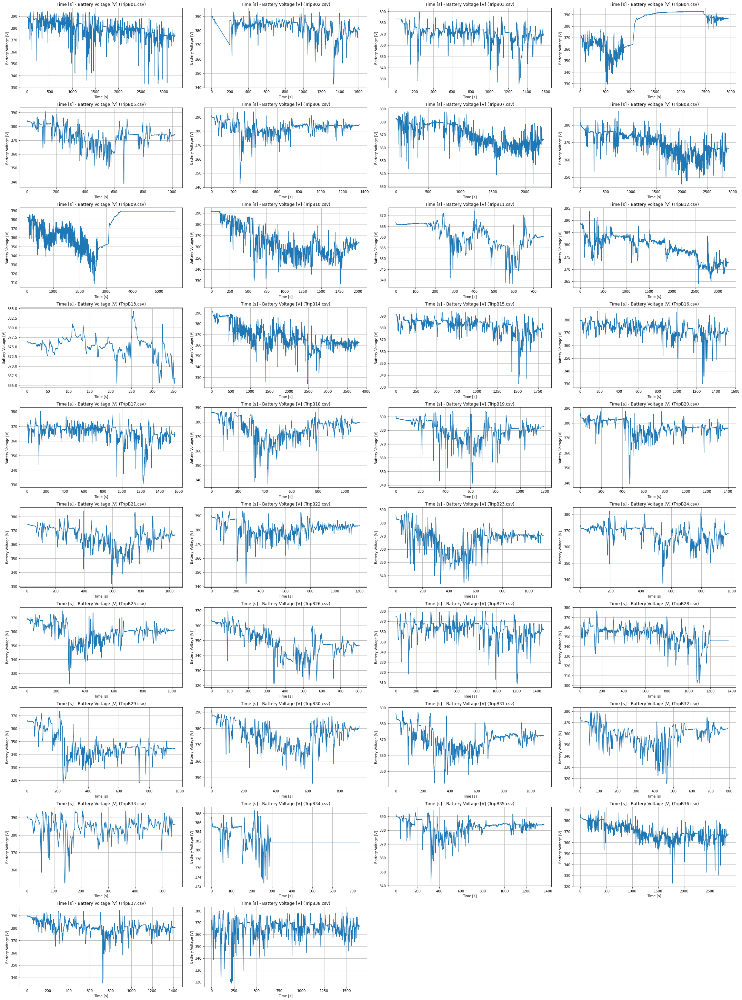

In [47]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[   "TripB01.csv",
    "TripB02.csv",
    "TripB03.csv",
    "TripB04.csv",
    "TripB05.csv",
    "TripB06.csv",
    "TripB07.csv",
    "TripB08.csv",
    "TripB09.csv",
    "TripB10.csv",
    "TripB11.csv",
    "TripB12.csv",
    "TripB13.csv",
    "TripB14.csv",
    "TripB15.csv",
    "TripB16.csv",
    "TripB17.csv",
    "TripB18.csv",
    "TripB19.csv",
    "TripB20.csv",
    "TripB21.csv",
    "TripB22.csv",
    "TripB23.csv",
    "TripB24.csv",
    "TripB25.csv",
    "TripB26.csv",
    "TripB27.csv",
    "TripB28.csv",
    "TripB29.csv",
    "TripB30.csv",
    "TripB31.csv",
    "TripB32.csv",
    "TripB33.csv",
    "TripB34.csv",
    "TripB35.csv",
    "TripB36.csv",
    "TripB37.csv",
    "TripB38.csv"
]


df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'Battery Voltage [V]'

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


In [164]:
# import pandas as pd
# import chardet

# def calculate_average_fluctuations(data):
#     average_fluctuations = data.diff().abs().mean()
#     return average_fluctuations

# # Specify the feature/column to calculate average fluctuations
# feature = 'Battery Voltage [V]'

# # List of dataset files
# file_list = [
#     "TripA01.csv",
#     "TripA02.csv",
#     "TripA03.csv",
#     "TripA04.csv",
#     "TripA05.csv",
#     "TripA06.csv",
#     "TripA07.csv",
#     "TripA08.csv",
#     "TripA09.csv",
#     "TripA10.csv",
#     "TripA11.csv",
#     "TripA12.csv",
#     "TripA13.csv",
#     "TripA14.csv",
#     "TripA15.csv",
#     "TripA16.csv",
#     "TripA17.csv",
#     "TripA18.csv",
#     "TripA19.csv",
#     "TripA20.csv",
#     "TripA21.csv",
#     "TripA22.csv",
#     "TripA23.csv",
#     "TripA24.csv",
#     "TripA25.csv",
#     "TripA26.csv",
#     "TripA27.csv",
#     "TripA28.csv",
#     "TripA29.csv",
#     "TripA30.csv",
#     "TripA31.csv",
#     "TripA32.csv",
#     "TripB01.csv",
#     "TripB02.csv",
#     "TripB03.csv",
#     "TripB04.csv",
#     "TripB05.csv",
#     "TripB06.csv",
#     "TripB07.csv",
#     "TripB08.csv",
#     "TripB09.csv",
#     "TripB10.csv",
#     "TripB11.csv",
#     "TripB12.csv",
#     "TripB13.csv",
#     "TripB14.csv",
#     "TripB15.csv",
#     "TripB16.csv",
#     "TripB17.csv",
#     "TripB18.csv",
#     "TripB19.csv",
#     "TripB20.csv",
#     "TripB21.csv",
#     "TripB22.csv",
#     "TripB23.csv",
#     "TripB24.csv",
#     "TripB25.csv",
#     "TripB26.csv",
#     "TripB27.csv",
#     "TripB28.csv",
#     "TripB29.csv",
#     "TripB30.csv",
#     "TripB31.csv",
#     "TripB32.csv",
#     "TripB33.csv",
#     "TripB34.csv",
#     "TripB35.csv",
#     "TripB36.csv",
#     "TripB37.csv"
# ]

# # Process each file
# for file in file_list:
#     # Read the file into a DataFrame
#     df = pd.read_csv(file, sep=';', encoding=chardet.detect(open(file, 'rb').read())['encoding'])
    
#     # Calculate the average absolute fluctuations for the specified feature
#     average_fluctuations = calculate_average_fluctuations(df[feature])
    
#     # Update the corresponding row in the result_df DataFrame
#     result_df.loc[result_df['File'] == file, 'Average Absolute Fluctuations in ' + feature] = average_fluctuations

# # Print the updated result_df DataFrame
# print(result_df)


Created a new feature of Voltage fluctaion as it is inversely proportional to battery range,so i calculated on an average how much fluctuations are there

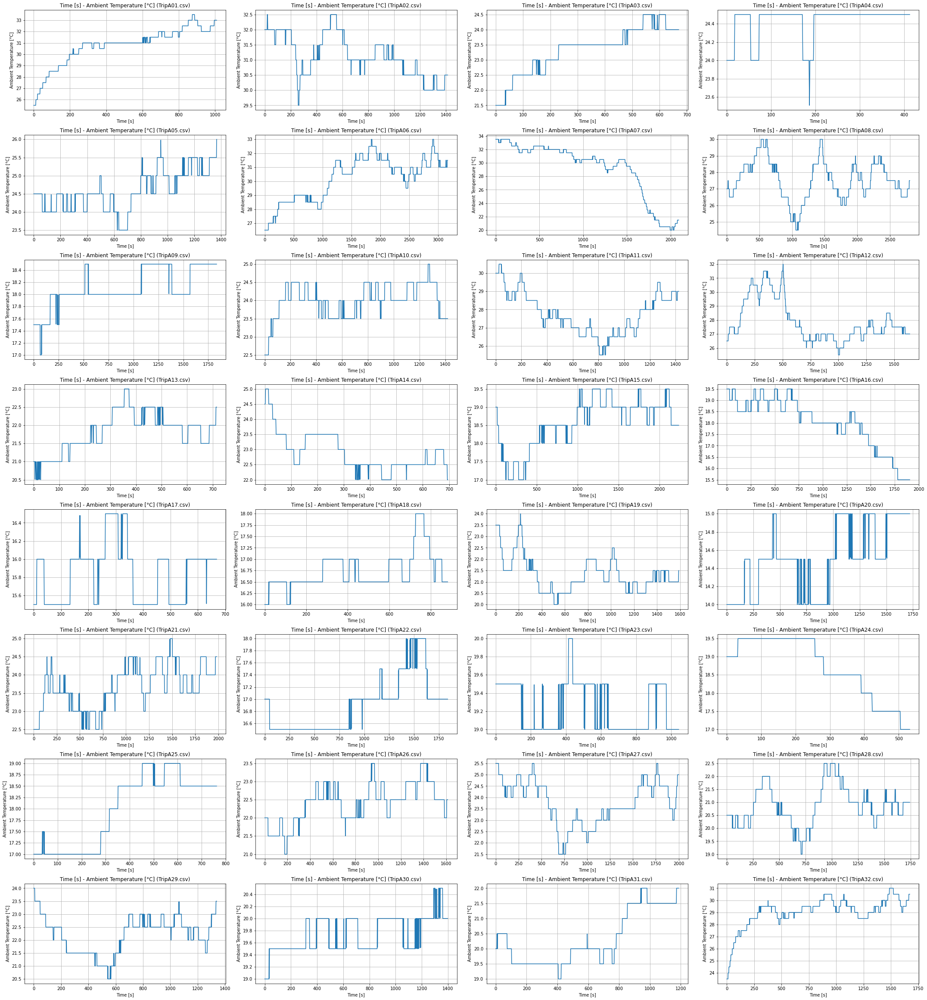

In [38]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[
    "TripA01.csv",
    "TripA02.csv",
    "TripA03.csv",
    "TripA04.csv",
    "TripA05.csv",
    "TripA06.csv",
    "TripA07.csv",
    "TripA08.csv",
    "TripA09.csv",
    "TripA10.csv",
    "TripA11.csv",
    "TripA12.csv",
    "TripA13.csv",
    "TripA14.csv",
    "TripA15.csv",
    "TripA16.csv",
    "TripA17.csv",
    "TripA18.csv",
    "TripA19.csv",
    "TripA20.csv",
    "TripA21.csv",
    "TripA22.csv",
    "TripA23.csv",
    "TripA24.csv",
    "TripA25.csv",
    "TripA26.csv",
    "TripA27.csv",
    "TripA28.csv",
    "TripA29.csv",
    "TripA30.csv",
    "TripA31.csv",
    "TripA32.csv",
]


df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'Ambient Temperature [°C]'

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


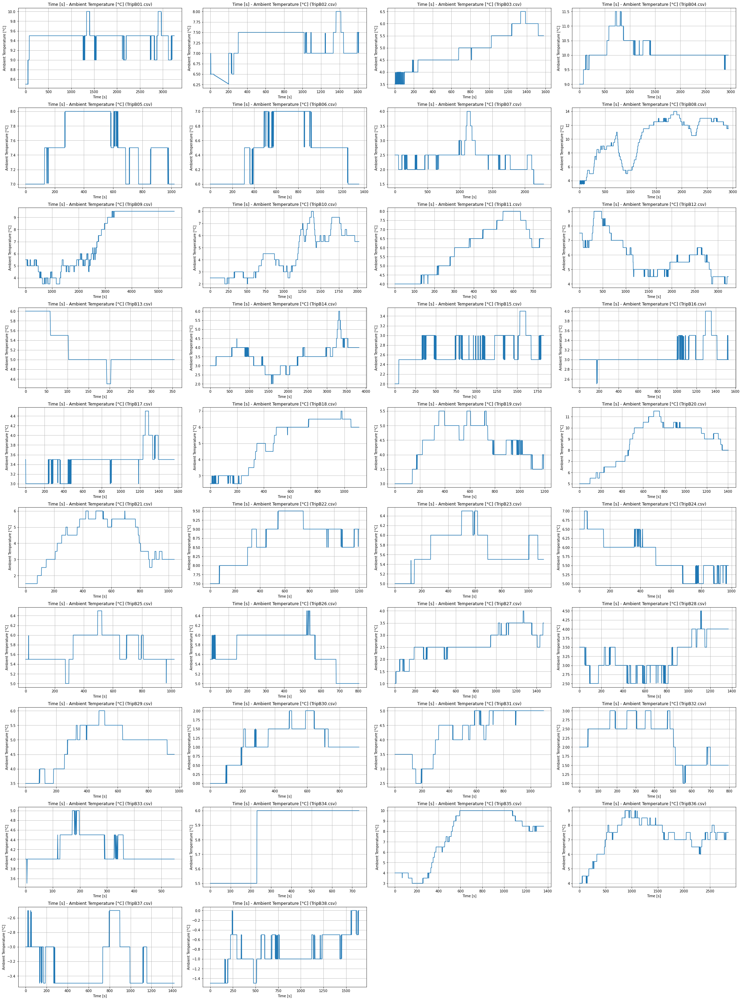

In [48]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[   "TripB01.csv",
    "TripB02.csv",
    "TripB03.csv",
    "TripB04.csv",
    "TripB05.csv",
    "TripB06.csv",
    "TripB07.csv",
    "TripB08.csv",
    "TripB09.csv",
    "TripB10.csv",
    "TripB11.csv",
    "TripB12.csv",
    "TripB13.csv",
    "TripB14.csv",
    "TripB15.csv",
    "TripB16.csv",
    "TripB17.csv",
    "TripB18.csv",
    "TripB19.csv",
    "TripB20.csv",
    "TripB21.csv",
    "TripB22.csv",
    "TripB23.csv",
    "TripB24.csv",
    "TripB25.csv",
    "TripB26.csv",
    "TripB27.csv",
    "TripB28.csv",
    "TripB29.csv",
    "TripB30.csv",
    "TripB31.csv",
    "TripB32.csv",
    "TripB33.csv",
    "TripB34.csv",
    "TripB35.csv",
    "TripB36.csv",
    "TripB37.csv",
    "TripB38.csv"
]


df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'Ambient Temperature [°C]'

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


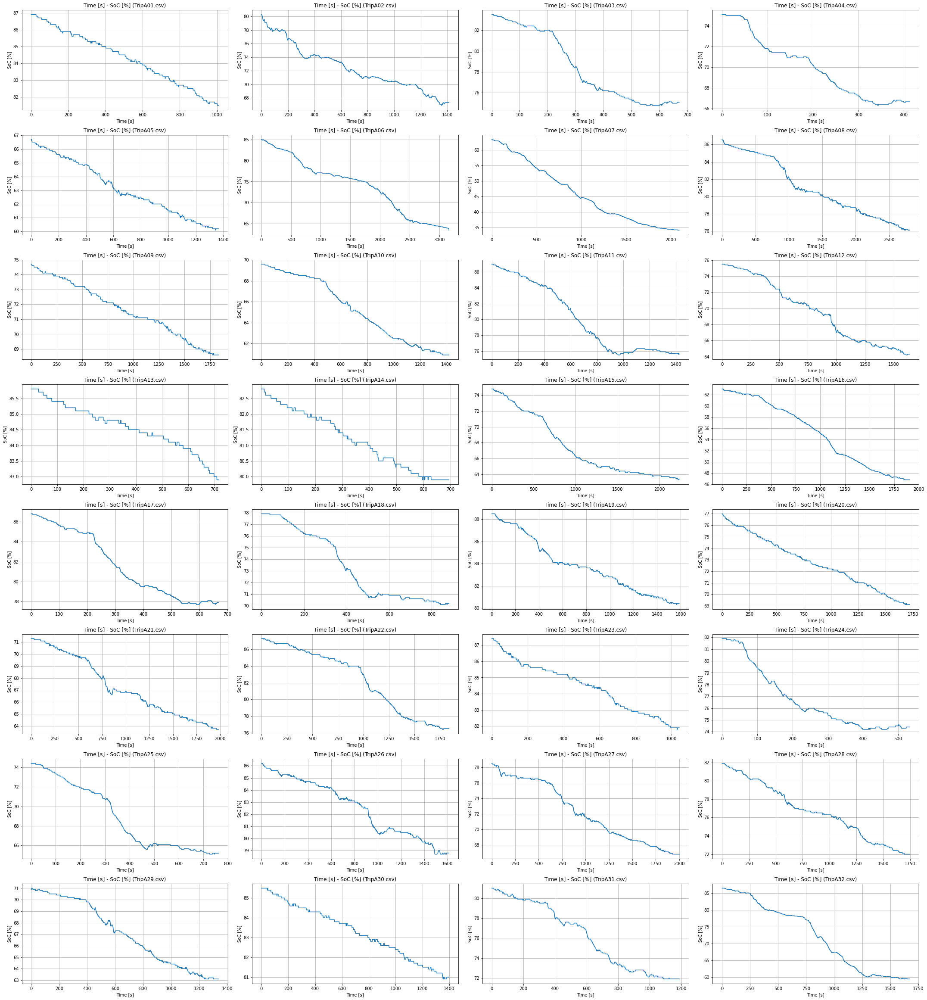

In [36]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[
    "TripA01.csv",
    "TripA02.csv",
    "TripA03.csv",
    "TripA04.csv",
    "TripA05.csv",
    "TripA06.csv",
    "TripA07.csv",
    "TripA08.csv",
    "TripA09.csv",
    "TripA10.csv",
    "TripA11.csv",
    "TripA12.csv",
    "TripA13.csv",
    "TripA14.csv",
    "TripA15.csv",
    "TripA16.csv",
    "TripA17.csv",
    "TripA18.csv",
    "TripA19.csv",
    "TripA20.csv",
    "TripA21.csv",
    "TripA22.csv",
    "TripA23.csv",
    "TripA24.csv",
    "TripA25.csv",
    "TripA26.csv",
    "TripA27.csv",
    "TripA28.csv",
    "TripA29.csv",
    "TripA30.csv",
    "TripA31.csv",
    "TripA32.csv",
]


df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'SoC [%]'

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


decrease of SOC is linear in nature

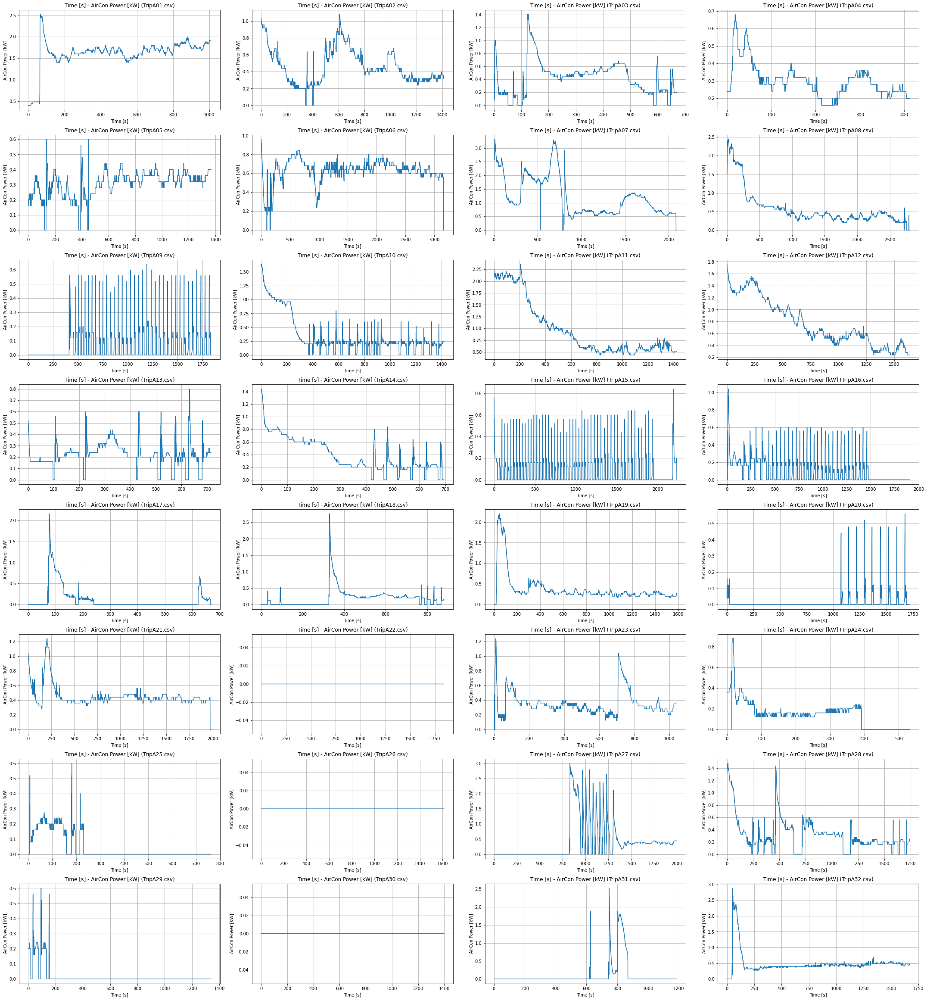

In [37]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[
    "TripA01.csv",
    "TripA02.csv",
    "TripA03.csv",
    "TripA04.csv",
    "TripA05.csv",
    "TripA06.csv",
    "TripA07.csv",
    "TripA08.csv",
    "TripA09.csv",
    "TripA10.csv",
    "TripA11.csv",
    "TripA12.csv",
    "TripA13.csv",
    "TripA14.csv",
    "TripA15.csv",
    "TripA16.csv",
    "TripA17.csv",
    "TripA18.csv",
    "TripA19.csv",
    "TripA20.csv",
    "TripA21.csv",
    "TripA22.csv",
    "TripA23.csv",
    "TripA24.csv",
    "TripA25.csv",
    "TripA26.csv",
    "TripA27.csv",
    "TripA28.csv",
    "TripA29.csv",
    "TripA30.csv",
    "TripA31.csv",
    "TripA32.csv",
]


df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'AirCon Power [kW]'

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


In [163]:
# import pandas as pd
# import chardet

# def calculate_average_change(data):
#     average_change = data.diff().mean()
#     return average_change

# # Specify the feature/column to calculate average change
# feature = 'AirCon Power [kW]'

# # List of dataset files
# file_list =[
#     "TripA01.csv",
#     "TripA02.csv",
#     "TripA03.csv",
#     "TripA04.csv",
#     "TripA05.csv",
#     "TripA06.csv",
#     "TripA07.csv",
#     "TripA08.csv",
#     "TripA09.csv",
#     "TripA10.csv",
#     "TripA11.csv",
#     "TripA12.csv",
#     "TripA13.csv",
#     "TripA14.csv",
#     "TripA15.csv",
#     "TripA16.csv",
#     "TripA17.csv",
#     "TripA18.csv",
#     "TripA19.csv",
#     "TripA20.csv",
#     "TripA21.csv",
#     "TripA22.csv",
#     "TripA23.csv",
#     "TripA24.csv",
#     "TripA25.csv",
#     "TripA26.csv",
#     "TripA27.csv",
#     "TripA28.csv",
#     "TripA29.csv",
#     "TripA30.csv",
#     "TripA31.csv",
#     "TripA32.csv",
#     "TripB01.csv",
#     "TripB02.csv",
#     "TripB03.csv",
#     "TripB04.csv",
#     "TripB05.csv",
#     "TripB06.csv",
#     "TripB07.csv",
#     "TripB08.csv",
#     "TripB09.csv",
#     "TripB10.csv",
#     "TripB11.csv",
#     "TripB12.csv",
#     "TripB13.csv",
#     "TripB14.csv",
#     "TripB15.csv",
#     "TripB16.csv",
#     "TripB17.csv",
#     "TripB18.csv",
#     "TripB19.csv",
#     "TripB20.csv",
#     "TripB21.csv",
#     "TripB22.csv",
#     "TripB23.csv",
#     "TripB24.csv",
#     "TripB25.csv",
#     "TripB26.csv",
#     "TripB27.csv",
#     "TripB28.csv",
#     "TripB29.csv",
#     "TripB30.csv",
#     "TripB31.csv",
#     "TripB32.csv",
#     "TripB33.csv",
#     "TripB34.csv",
#     "TripB35.csv",
#     "TripB36.csv",
#     "TripB37.csv"
# ]

# # Process each file
# for file in file_list:
#     # Read the file into a DataFrame
#     df = pd.read_csv(file, sep=';', encoding=chardet.detect(open(file, 'rb').read())['encoding'])
    
#     # Calculate the average change for the specified feature
#     average_change = calculate_average_change(df[feature])
    
#     # Update the corresponding row in the result_df DataFrame
#     result_df.loc[result_df['File'] == file, 'Average Change in ' + feature] = average_change

# # Print the updated result_df DataFrame
# print(result_df)


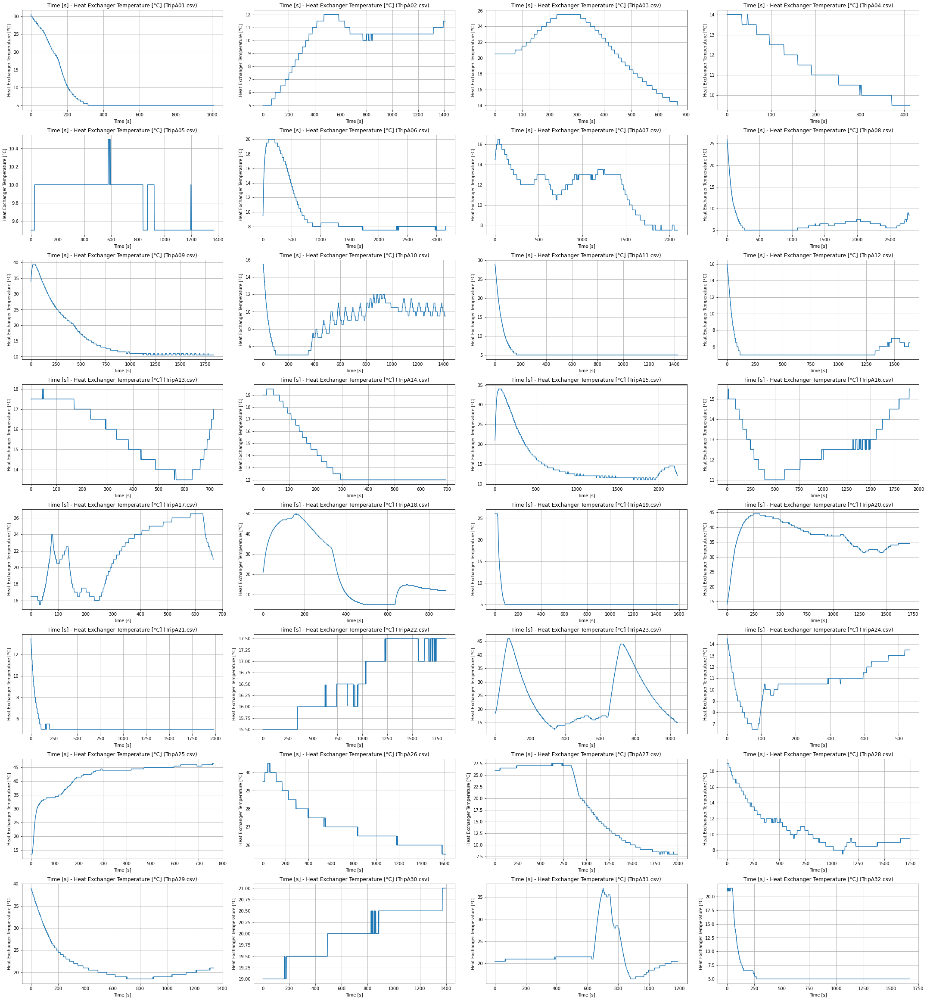

In [40]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[
    "TripA01.csv",
    "TripA02.csv",
    "TripA03.csv",
    "TripA04.csv",
    "TripA05.csv",
    "TripA06.csv",
    "TripA07.csv",
    "TripA08.csv",
    "TripA09.csv",
    "TripA10.csv",
    "TripA11.csv",
    "TripA12.csv",
    "TripA13.csv",
    "TripA14.csv",
    "TripA15.csv",
    "TripA16.csv",
    "TripA17.csv",
    "TripA18.csv",
    "TripA19.csv",
    "TripA20.csv",
    "TripA21.csv",
    "TripA22.csv",
    "TripA23.csv",
    "TripA24.csv",
    "TripA25.csv",
    "TripA26.csv",
    "TripA27.csv",
    "TripA28.csv",
    "TripA29.csv",
    "TripA30.csv",
    "TripA31.csv",
    "TripA32.csv",
]


df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'Heat Exchanger Temperature [°C]'

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


In [162]:
# import pandas as pd
# import chardet

# def calculate_total_change(data):
#     total_change = data.diff().sum()
#     return total_change

# # Specify the feature/column to calculate total change
# feature = 'Heat Exchanger Temperature [°C]'

# # List of dataset files
# file_list = [
#     "TripA01.csv",
#     "TripA02.csv",
#     "TripA03.csv",
#     "TripA04.csv",
#     "TripA05.csv",
#     "TripA06.csv",
#     "TripA07.csv",
#     "TripA08.csv",
#     "TripA09.csv",
#     "TripA10.csv",
#     "TripA11.csv",
#     "TripA12.csv",
#     "TripA13.csv",
#     "TripA14.csv",
#     "TripA15.csv",
#     "TripA16.csv",
#     "TripA17.csv",
#     "TripA18.csv",
#     "TripA19.csv",
#     "TripA20.csv",
#     "TripA21.csv",
#     "TripA22.csv",
#     "TripA23.csv",
#     "TripA24.csv",
#     "TripA25.csv",
#     "TripA26.csv",
#     "TripA27.csv",
#     "TripA28.csv",
#     "TripA29.csv",
#     "TripA30.csv",
#     "TripA31.csv",
#     "TripA32.csv",
#     "TripB01.csv",
#     "TripB02.csv",
#     "TripB03.csv",
#     "TripB04.csv",
#     "TripB05.csv",
#     "TripB06.csv",
#     "TripB07.csv",
#     "TripB08.csv",
#     "TripB09.csv",
#     "TripB10.csv",
#     "TripB11.csv",
#     "TripB12.csv",
#     "TripB13.csv",
#     "TripB14.csv",
#     "TripB15.csv",
#     "TripB16.csv",
#     "TripB17.csv",
#     "TripB18.csv",
#     "TripB19.csv",
#     "TripB20.csv",
#     "TripB21.csv",
#     "TripB22.csv",
#     "TripB23.csv",
#     "TripB24.csv",
#     "TripB25.csv",
#     "TripB26.csv",
#     "TripB27.csv",
#     "TripB28.csv",
#     "TripB29.csv",
#     "TripB30.csv",
#     "TripB31.csv",
#     "TripB32.csv",
#     "TripB33.csv",
#     "TripB34.csv",
#     "TripB35.csv",
#     "TripB36.csv",
#     "TripB37.csv"
# ]

# # Process each file
# for file in file_list:
#     # Read the file into a DataFrame
#     df = pd.read_csv(file, sep=';', encoding=chardet.detect(open(file, 'rb').read())['encoding'])
    
#     # Calculate the total change for the specified feature
#     total_change = calculate_total_change(df[feature])
    
#     # Update the corresponding row in the result_df DataFrame
#     result_df.loc[result_df['File'] == file, 'Total Change in ' + feature] = total_change

# # Print the updated result_df DataFrame
# print(result_df)


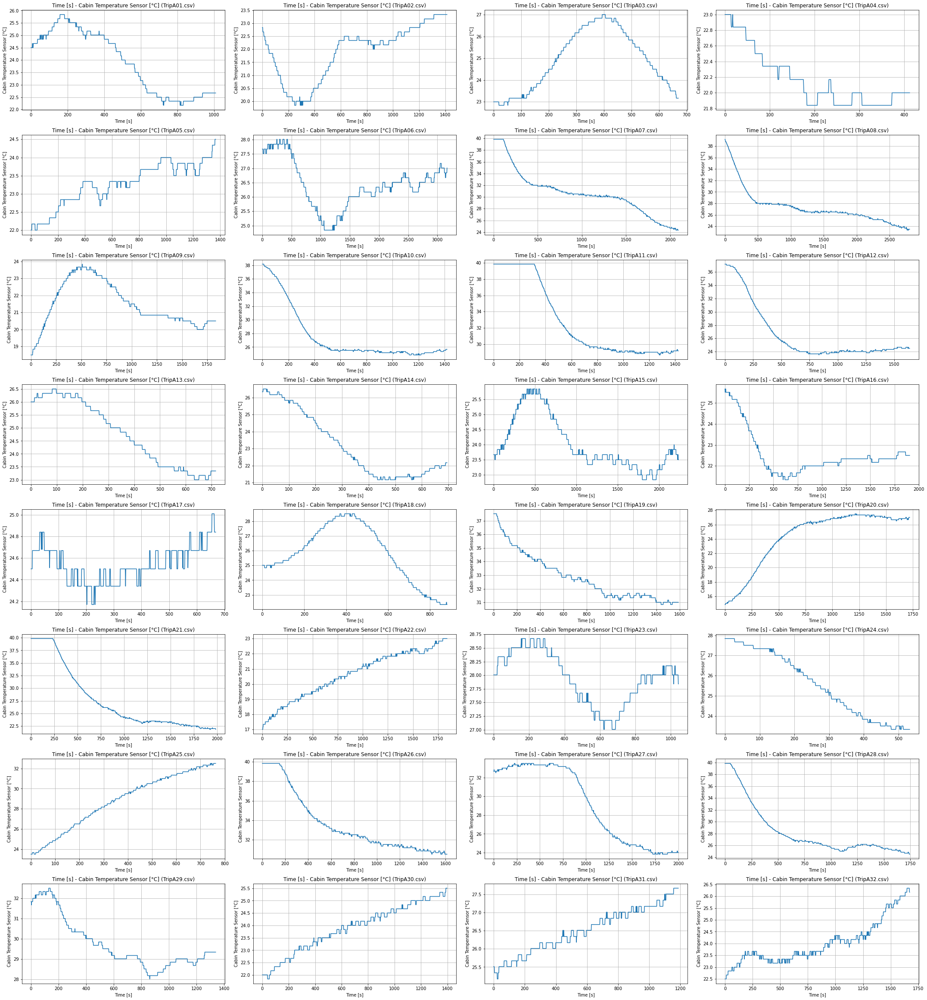

In [41]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt

def plot_dataframe_subplots(df_list, feature, nrows, ncols, figsize=(30, 24)):
    """Plot a nrows x ncols grid of the specified feature for the list of dataframes"""
    plt.figure(figsize=figsize)
    for idx, df in enumerate(df_list):
        plt.subplot(nrows, ncols, idx+1)
        plt.plot(np.array(range(df.shape[0])) * 0.1, df[feature])
        plt.ylabel(feature)
        plt.grid(True)
        plt.xlabel(df.columns[0])  # Assuming all dataframes have the same x-axis column
        plt.title(df.columns[0] + ' - ' + feature + ' (' + file_list[idx] + ')')
    plt.tight_layout()  # Adjust the spacing between subplots for better visualization
    plt.show()

# Read multiple files and store dataframes in a list
file_list =[
    "TripA01.csv",
    "TripA02.csv",
    "TripA03.csv",
    "TripA04.csv",
    "TripA05.csv",
    "TripA06.csv",
    "TripA07.csv",
    "TripA08.csv",
    "TripA09.csv",
    "TripA10.csv",
    "TripA11.csv",
    "TripA12.csv",
    "TripA13.csv",
    "TripA14.csv",
    "TripA15.csv",
    "TripA16.csv",
    "TripA17.csv",
    "TripA18.csv",
    "TripA19.csv",
    "TripA20.csv",
    "TripA21.csv",
    "TripA22.csv",
    "TripA23.csv",
    "TripA24.csv",
    "TripA25.csv",
    "TripA26.csv",
    "TripA27.csv",
    "TripA28.csv",
    "TripA29.csv",
    "TripA30.csv",
    "TripA31.csv",
    "TripA32.csv",
]


df_list = []
for file in file_list:
    df = pd.read_csv(
        file,
        sep=';',
        encoding=chardet.detect(open(file, 'rb').read())['encoding']
    )
    df_list.append(df)

# Specify the feature/column to plot
feature_to_plot = 'Cabin Temperature Sensor [°C]'

# Plot the specified feature for all the files
plot_dataframe_subplots(df_list, feature_to_plot, nrows=12, ncols=4, figsize=(30, 48))


In [161]:
# import pandas as pd

# # Remove the ".csv" extension from the file names
# result_df['File'] = result_df['File'].str.replace(".csv", "")

# # Print the updated df_result DataFrame
# print(result_df)


In [160]:
# result_df['Trip'] = result_df['Trip'].str.replace(".csv", "") + ".csv"
# print(result_df)

In [127]:
result_df['Trip'] = result_df['Trip'].str.replace(".csv", "") 

Merging result_df and Overview file

In [213]:
# Concatenate the two dataframes based on matching the first column name
merged_df = pd.concat([df_overview.set_index(df_overview.columns[0]), result_df.set_index(result_df.columns[0])], axis=1, join='outer')

# Reset the index to have the first column as a regular column
merged_df = merged_df.reset_index()

# Print the merged dataframe
print(merged_df)
merged_df.to_csv('Final1.csv')

       Trip                 Date    Route/Area          Weather  \
0   TripA01  2019-06-25_13-21-14   Munich East            sunny   
1   TripA02  2019-06-25_14-05-31   Munich East            sunny   
2   TripA03  2019-06-28_10-02-15   Munich East            sunny   
3   TripA04  2019-06-28_10-13-30   Munich East            sunny   
4   TripA05  2019-06-28_10-20-26   Munich East            sunny   
..      ...                  ...           ...              ...   
64  TripB33  2020-01-14_11-44-28  Munich North           cloudy   
65  TripB34  2020-01-14_12-55-08  Munich North           cloudy   
66  TripB35  2020-01-14_17-59-06  Munich North             dark   
67  TripB36  2020-01-15_10-43-44  Munich North            sunny   
68  TripB37  2020-01-21_09-15-20   Munich East  slightly cloudy   

    Battery Temperature (Start) [°C]  Battery Temperature (End)  \
0                               21.0                       22.0   
1                               23.0                       26

In [130]:
merged_df.head()

,Trip,Date,Route/Area,Weather,Battery Temperature (Start) [°C],Battery Temperature (End),Battery State of Charge (Start),Battery State of Charge (End),SoC difference,Ambient Temperature (Start) [°C],...,Peaks,Rash Driving Order,Elevation travelled,Peak_Torque,Changes in Longitudinal Acceleration [m/s^2],Peaks and Falls in Longitudinal Acceleration [m/s^2],Total Change in Heat Exchanger Temperature [°C],Average Change in AirCon Power [kW],Average Absolute Fluctuations in Battery Voltage [V],Signals in Regenerative Braking Signal
0,TripA01,2019-06-25_13-21-14,Munich East,sunny,21.0,22.0,0.863,0.803,0.060,25.5,...,572,Third,393053.5,1146.0,9408.0,834.0,-25.5,0.000151,0.108443,1205.0
1,TripA02,2019-06-25_14-05-31,Munich East,sunny,23.0,26.0,0.803,0.673,0.130,32.0,...,838,Third,1052959.5,1432.0,13596.0,1743.0,6.5,-0.000051,0.190219,1726.0
2,TripA03,2019-06-28_10-02-15,Munich East,sunny,24.0,25.0,0.835,0.751,0.084,21.5,...,444,Low Priority,752056.5,556.0,6420.0,888.0,-6.5,-0.000042,0.176427,418.0
3,TripA04,2019-06-28_10-13-30,Munich East,sunny,25.0,27.0,0.751,0.667,0.084,24.0,...,278,Low Priority,0,244.0,3952.0,567.0,-4.5,-0.000010,0.188363,186.0
4,TripA05,2019-06-28_10-20-26,Munich East,sunny,27.0,27.0,0.667,0.602,0.065,24.5,...,961,Third,738356.5,1627.0,12869.0,1430.0,0.0,0.000015,0.095953,1550.0


As per SOC graph,vs time ,it is seen that it is a linear in nature,so my assumptions is that it fall linearly from 100% to 0%

In [98]:
# Create the new column 'Range' by dividing 'Distance [km]' by 'SoC difference'
concatenated_df['Range'] = concatenated_df['Distance [km]'] / concatenated_df['SoC difference']

# Print the updated merged dataframe
print(concatenated_df)


   Velocity_Info  Elevation_Travelled  \
0      20.186638            393053.50   
1      46.436352           1052959.50   
2       1.192714            752056.50   
3       8.313974                 0.00   
4      -0.037039            738356.50   
..           ...                  ...   
66       0.12071           1482015.00   
67      -0.04262           5568640.96   
68     -0.046091           1348961.50   
69           NaN                  NaN   
70           NaN                  NaN   

    Signals in Regenerative Braking Signal   Peak_Torque     Trip  \
0                                    1205.0       1146.0  TripA01   
1                                    1726.0       1432.0  TripA02   
2                                     418.0        556.0  TripA03   
3                                     186.0        244.0  TripA04   
4                                    1550.0       1627.0  TripA05   
..                                      ...          ...      ...   
66                      

In [100]:
concatenated_df.dropna()

,Velocity_Info,Elevation_Travelled,Signals in Regenerative Braking Signal,Peak_Torque,Trip,Route/Area,Battery Temperature (Start) [°C],Battery Temperature (End),Battery State of Charge (Start),Battery State of Charge (End),SoC difference,Ambient Temperature (Start) [°C],Target Cabin Temperature,Distance [km],Duration [min],Driving Cycle,Range
0,20.186638,393053.50,1205.0,1146.0,TripA01,Munich East,21.0,22.0,0.863,0.803,0.060,25.5,23.0,7.427690,16.820000,1.0,123.794829
1,46.436352,1052959.50,1726.0,1432.0,TripA02,Munich East,23.0,26.0,0.803,0.673,0.130,32.0,23.0,23.509709,23.550000,1.0,180.843917
2,1.192714,752056.50,418.0,556.0,TripA03,Munich East,24.0,25.0,0.835,0.751,0.084,21.5,27.0,12.820846,11.180000,1.0,152.629120
3,8.313974,0.00,186.0,244.0,TripA04,Munich East,25.0,27.0,0.751,0.667,0.084,24.0,22.0,10.727491,6.870000,1.0,127.708231
4,-0.037039,738356.50,1550.0,1627.0,TripA05,Munich East,27.0,27.0,0.667,0.602,0.065,24.5,24.0,12.393223,22.776667,1.0,190.664976
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64,0.04491,0.00,510.0,721.0,TripB31,Munich North,6.0,8.0,0.721,0.578,0.143,3.5,22.0,15.241400,18.280000,2.0,106.583217
65,57.864353,279003.00,123.0,318.0,TripB32,Munich North,4.0,7.0,0.526,0.381,0.145,2.0,22.0,14.240900,13.261667,2.0,98.213103
66,0.12071,1482015.00,403.0,1451.0,TripB33,Munich North,11.0,12.0,0.774,0.716,0.058,4.0,22.0,7.033500,9.131667,2.0,121.267241
67,-0.04262,5568640.96,1330.0,3276.0,TripB34,Munich North,11.0,11.0,0.739,0.713,0.026,5.5,22.0,9.143200,12.228333,2.0,351.661538


In [101]:
concatenated_df.corr()

,Elevation_Travelled,Signals in Regenerative Braking Signal,Peak_Torque,Battery Temperature (Start) [°C],Battery Temperature (End),Battery State of Charge (Start),Battery State of Charge (End),SoC difference,Ambient Temperature (Start) [°C],Target Cabin Temperature,Distance [km],Duration [min],Driving Cycle,Range
Elevation_Travelled,1.000000,0.280093,0.585008,0.109356,0.061144,0.096747,0.051434,0.018735,0.085092,0.025915,0.146831,0.109171,0.013361,0.260218
Signals in Regenerative Braking Signal,0.280093,1.000000,0.519387,0.442992,0.454076,0.338632,0.324005,-0.030370,0.475072,0.243566,0.034158,0.210939,-0.317143,0.356909
Peak_Torque,0.585008,0.519387,1.000000,0.154955,0.177299,0.171787,-0.012333,0.193269,0.091327,0.003984,0.403374,0.370804,0.084354,0.334256
Battery Temperature (Start) [°C],0.109356,0.442992,0.154955,1.000000,0.939466,0.252958,0.446794,-0.242149,0.890903,0.526692,-0.217335,-0.162422,-0.479785,0.351707
Battery Temperature (End),0.061144,0.454076,0.177299,0.939466,1.000000,0.265260,0.368946,-0.127087,0.908817,0.525491,0.017028,0.054999,-0.371240,0.305817
Battery State of Charge (Start),0.096747,0.338632,0.171787,0.252958,0.265260,1.000000,0.803654,0.154092,0.362788,0.329253,0.106988,0.101963,-0.398773,0.261401
Battery State of Charge (End),0.051434,0.324005,-0.012333,0.446794,0.368946,0.803654,1.000000,-0.280266,0.485743,0.381375,-0.381412,-0.181468,-0.491669,0.194559
SoC difference,0.018735,-0.030370,0.193269,-0.242149,-0.127087,0.154092,-0.280266,1.000000,-0.128515,-0.036542,0.626273,0.334300,0.128292,-0.154999
Ambient Temperature (Start) [°C],0.085092,0.475072,0.091327,0.890903,0.908817,0.362788,0.485743,-0.128515,1.000000,0.604315,-0.067879,-0.026291,-0.555097,0.393877
Target Cabin Temperature,0.025915,0.243566,0.003984,0.526692,0.525491,0.329253,0.381375,-0.036542,0.604315,1.000000,-0.046635,-0.068406,-0.406297,0.252099


In [137]:
merged_df.columns

Index(['Trip', 'Date', 'Route/Area', 'Weather',
       'Battery Temperature (Start) [°C]', 'Battery Temperature (End)',
       'Battery State of Charge (Start)', 'Battery State of Charge (End)',
       'SoC difference', 'Ambient Temperature (Start) [°C]',
       'Target Cabin Temperature', 'Distance [km]', 'Duration [min]', 'Fan',
       'Peaks', 'Rash Driving Order', 'Elevation travelled', 'Peak_Torque',
       'Changes in Longitudinal Acceleration [m/s^2]',
       'Peaks and Falls in Longitudinal Acceleration [m/s^2]',
       'Total Change in Heat Exchanger Temperature [°C]',
       'Average Change in AirCon Power [kW]',
       'Average Absolute Fluctuations in Battery Voltage [V]',
       'Signals in Regenerative Braking Signal ', 'Range'],
      dtype='object')

In [102]:
concatenated_df.to_csv('Final dataset2.csv')#Saving the dataset

Dopping Unneccessary Columns like Peaks,Duration,Distance,SOC(as it has been calculated),Battery Temperature (End)(it is highly correlated to battery temp start),Date,Route,Weather,Fan,Changes in Longitudinal Acceleration [m/s^2]

In [103]:
concatenated_df=concatenated_df.drop(columns=['Trip','Route/Area'],axis=1)

In [104]:
concatenated_df.head()

,Velocity_Info,Elevation_Travelled,Signals in Regenerative Braking Signal,Peak_Torque,Battery Temperature (Start) [°C],Battery Temperature (End),Battery State of Charge (Start),Battery State of Charge (End),SoC difference,Ambient Temperature (Start) [°C],Target Cabin Temperature,Distance [km],Duration [min],Driving Cycle,Range
0,20.186638,393053.5,1205.0,1146.0,21.0,22.0,0.863,0.803,0.060,25.5,23.0,7.427690,16.820000,1.0,123.794829
1,46.436352,1052959.5,1726.0,1432.0,23.0,26.0,0.803,0.673,0.130,32.0,23.0,23.509709,23.550000,1.0,180.843917
2,1.192714,752056.5,418.0,556.0,24.0,25.0,0.835,0.751,0.084,21.5,27.0,12.820846,11.180000,1.0,152.629120
3,8.313974,0.0,186.0,244.0,25.0,27.0,0.751,0.667,0.084,24.0,22.0,10.727491,6.870000,1.0,127.708231
4,-0.037039,738356.5,1550.0,1627.0,27.0,27.0,0.667,0.602,0.065,24.5,24.0,12.393223,22.776667,1.0,190.664976


In [105]:
columns_to_encode = ['Driving Cycle']

# Apply one-hot encoding to the specified columns
df = pd.get_dummies(concatenated_df, columns=columns_to_encode)


In [107]:
df.columns

Index(['Velocity_Info', 'Elevation_Travelled',
       'Signals in Regenerative Braking Signal ', 'Peak_Torque',
       'Battery Temperature (Start) [°C]', 'Battery Temperature (End)',
       'Battery State of Charge (Start)', 'Battery State of Charge (End)',
       'SoC difference', 'Ambient Temperature (Start) [°C]',
       'Target Cabin Temperature', 'Distance [km]', 'Duration [min]', 'Range',
       'Driving Cycle_1.0', 'Driving Cycle_2.0', 'Driving Cycle_3.0',
       'Driving Cycle_4.0', 'Driving Cycle_5.0', 'Driving Cycle_6.0',
       'Driving Cycle_7.0'],
      dtype='object')

In [108]:
df=df.drop(columns=['Battery Temperature (Start) [°C]','Battery State of Charge (Start)', 'Battery State of Charge (End)',
       'SoC difference'],axis=1)

In [109]:
df['Change in Ambient Temp']=df['Target Cabin Temperature']-df['Ambient Temperature (Start) [°C]']

In [110]:
df.head()

,Velocity_Info,Elevation_Travelled,Signals in Regenerative Braking Signal,Peak_Torque,Battery Temperature (End),Ambient Temperature (Start) [°C],Target Cabin Temperature,Distance [km],Duration [min],Range,Driving Cycle_1.0,Driving Cycle_2.0,Driving Cycle_3.0,Driving Cycle_4.0,Driving Cycle_5.0,Driving Cycle_6.0,Driving Cycle_7.0,Change in Ambient Temp
0,20.186638,393053.5,1205.0,1146.0,22.0,25.5,23.0,7.427690,16.820000,123.794829,1,0,0,0,0,0,0,-2.5
1,46.436352,1052959.5,1726.0,1432.0,26.0,32.0,23.0,23.509709,23.550000,180.843917,1,0,0,0,0,0,0,-9.0
2,1.192714,752056.5,418.0,556.0,25.0,21.5,27.0,12.820846,11.180000,152.629120,1,0,0,0,0,0,0,5.5
3,8.313974,0.0,186.0,244.0,27.0,24.0,22.0,10.727491,6.870000,127.708231,1,0,0,0,0,0,0,-2.0
4,-0.037039,738356.5,1550.0,1627.0,27.0,24.5,24.0,12.393223,22.776667,190.664976,1,0,0,0,0,0,0,-0.5


In [111]:
df=df.drop(columns=['Target Cabin Temperature','Ambient Temperature (Start) [°C]'],axis=1)

In [113]:
df=df.dropna()

In [120]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 67 entries, 0 to 68
Data columns (total 16 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   Velocity_Info                            67 non-null     int32  
 1   Elevation_Travelled                      67 non-null     float64
 2   Signals in Regenerative Braking Signal   67 non-null     float64
 3   Peak_Torque                              67 non-null     float64
 4   Battery Temperature (End)                67 non-null     float64
 5   Distance [km]                            67 non-null     float64
 6   Duration [min]                           67 non-null     float64
 7   Range                                    67 non-null     float64
 8   Driving Cycle_1.0                        67 non-null     uint8  
 9   Driving Cycle_2.0                        67 non-null     uint8  
 10  Driving Cycle_3.0                        67 non-null

One hot encoding of classification column

In [115]:
df['Velocity_Info'] = df['Velocity_Info'].astype(int)

In [34]:
df.iloc[:,1:].columns

Index(['Battery Temperature (End)', 'Ambient Temperature (Start) [°C]',
       'Target Cabin Temperature', 'Elevation travelled', 'Peak_Torque',
       'Peaks and Falls in Longitudinal Acceleration [m/s^2]',
       'Total Change in Heat Exchanger Temperature [°C]',
       'Average Change in AirCon Power [kW]',
       'Average Absolute Fluctuations in Battery Voltage [V]',
       'Signals in Regenerative Braking Signal ', 'Range',
       'Rash Driving Order_First', 'Rash Driving Order_Low Priority',
       'Rash Driving Order_Second', 'Rash Driving Order_Third'],
      dtype='object')

In [35]:
df1=df.iloc[:,1:]#excluding the trip columns

## Model Building

In [121]:
X=df.drop('Range',axis=1)
y=df['Range'].values.reshape(-1,1)

In [122]:
X.shape,y.shape

((67, 15), (67, 1))

In [123]:
#As the data is of different scale,it will affect the prediction
from sklearn.preprocessing import StandardScaler
scaler_x = StandardScaler()
scaler_y = StandardScaler()

X_scaled = scaler_x.fit_transform(X)
Y_scaled = scaler_y.fit_transform(y)


In [124]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, Y_scaled, test_size=0.2, random_state=42)

In [145]:
def regression_matrics(y_test, y_pred):
    # calculate error
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    mae = mean_absolute_error(y_test, y_pred)
    # report error
    print(f'Root Mean Square Error: {rmse}')
    print(f'Mean Absolute Error: {mae}')

In [148]:
def plot_comparison(y_test, y_pred, xlabel, ylabel, dark_mode=False, figsize=(30, 6)):
    if dark_mode:
        plt.figure(figsize=figsize, facecolor='black')
        ax = plt.axes()
        ax.set_facecolor("black")
        ax.spines['bottom'].set_color('gray')
        ax.spines['top'].set_color('gray')
        ax.spines['right'].set_color('gray')
        ax.spines['left'].set_color('gray')
        ax.tick_params(colors='white', which='both')
        plt.plot(y_pred, color="yellow")
        plt.plot(y_test, color="white")
        plt.legend(['Predicted', 'Measured'])
        plt.xlabel(xlabel, color='white')
        plt.ylabel(ylabel, color='white')
    else:
        plt.figure(figsize=figsize)
        plt.plot(y_pred)
        plt.plot(y_test)        
        plt.legend(['Predicted', 'Measured'])
        plt.xlabel(xlabel)
        plt.ylabel(ylabel)
    plt.grid(True)

In [126]:
regressor = LinearRegression()
# 2. Fit the model
regressor.fit(X_train, y_train)
# 3. Make predicitons with the model
y_pred_lr = regressor.predict(X_test)
# 4. Evaluate and visualize
print('Linear Regression:')
regression_matrics(y_test, y_pred_lr)

Linear Regression:
Mean Squared Error: 1.4808046650369169
Root Mean Square Error: 1.2168831764129688
Mean Absolute Error: 0.8450582752271621


In [127]:
import statsmodels.api as sm

In [128]:
LR=sm.OLS(y_train,X_train)

In [129]:
LR_results = LR.fit()

In [130]:
print(LR_results.summary())

                                 OLS Regression Results                                
Dep. Variable:                      y   R-squared (uncentered):                   0.622
Model:                            OLS   Adj. R-squared (uncentered):              0.487
Method:                 Least Squares   F-statistic:                              4.589
Date:                Sat, 03 Jun 2023   Prob (F-statistic):                    8.06e-05
Time:                        16:40:42   Log-Likelihood:                         -50.824
No. Observations:                  53   AIC:                                      129.6
Df Residuals:                      39   BIC:                                      157.2
Df Model:                          14                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

In [138]:
print("X_train shape:", X_train.shape)
print("X_test shape:", X_test.shape)


X_train shape: (53, 14)
X_test shape: (14, 14)


My model can explain 62% of variablity

In [142]:
# Create and split train and test datasets
X = df.drop(['Range'],axis=1)
y = df[['Range']]
splitter = int(len(X)*0.7)
X_train = X.values[:splitter]
X_test = X.values[splitter:]
y_train = y.values[:splitter]
y_test = y.values[splitter:]
# Check the dataset sizes
X_train.shape, y_train.shape, X_test.shape, y_test.shape[0]

((46, 15), (46, 1), (21, 15), 21)

Linear Regression:
Root Mean Square Error: 52.66285503466503
Mean Absolute Error: 26.431630072757198


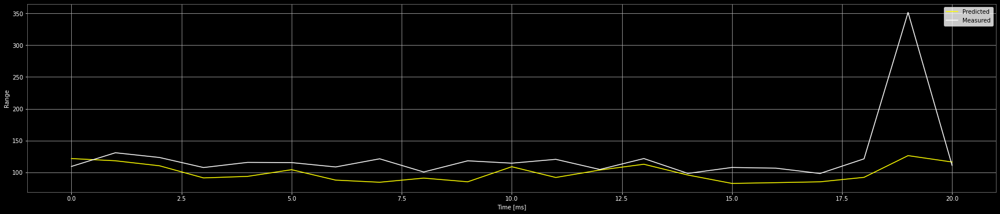

In [150]:
# 1. Create a model
regressor = LinearRegression()
# 2. Fit the model
regressor.fit(X_train, y_train)
# 3. Make predicitons with the model
y_pred_lr = regressor.predict(X_test)
# 4. Evaluate and visualize
print('Linear Regression:')
regression_matrics(y_test, y_pred_lr)
plot_comparison(y_test=y_test, y_pred=y_pred_lr, xlabel="Time [ms]", ylabel="Range", dark_mode=True)

In [157]:
from sklearn.preprocessing import MinMaxScaler

# Normalize the input features
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# 1. Create a model with a preprocessing layer for normalization
regressor = Sequential([
    layers.Input(shape=(X_train_scaled.shape[1],)),
    layers.BatchNormalization(),
    layers.Dense(64, activation='relu'),
    layers.Dense(64, activation='relu'),
    layers.Dense(1),
])

# 2. Compile the model
regressor.compile(optimizer=optimizers.Adam(learning_rate=0.001),
                  loss=losses.mae,
                  metrics=["mae"])

# 3. Fit the model with the normalized training data
history = regressor.fit(X_train_scaled, y_train, epochs=100, verbose=0)

# 4. Predict with the model using the normalized test data
y_pred_nn = regressor.predict(X_test_scaled)

# 5. Evaluate and visualize the results
print('Neural Network:')
regression_matrics(y_test, y_pred_nn)



1/1 [==============================] - 0s 81ms/step
Neural Network:
Root Mean Square Error: 61.78179250660691
Mean Absolute Error: 39.37492092343197


In [170]:
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers, optimizers, losses
from tensorflow.keras.callbacks import EarlyStopping

# Normalize the input features
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Reshape the input data for LSTM
X_train_reshaped = X_train_scaled.reshape((X_train_scaled.shape[0], X_train_scaled.shape[1], 1))
X_test_reshaped = X_test_scaled.reshape((X_test_scaled.shape[0], X_test_scaled.shape[1], 1))

# 1. Create an LSTM model
regressor = Sequential([
    layers.LSTM(64, activation='relu', input_shape=(X_train_scaled.shape[1], 1)),
    layers.Dense(1)
])

# 2. Compile the model
regressor.compile(optimizer=optimizers.Adam(learning_rate=0.001),
                  loss=losses.mae,
                  metrics=["mae"])

# 3. Fit the model with early stopping
early_stopping = EarlyStopping(patience=10, restore_best_weights=True)
history = regressor.fit(X_train_reshaped, y_train, epochs=100, validation_split=0.2, verbose=0, callbacks=[early_stopping])

# 4. Predict with the model using the normalized test data
y_pred_nn = regressor.predict(X_test_reshaped)

# 5. Evaluate and visualize the results
print('Neural Network (LSTM):')
regression_matrics(y_test, y_pred_nn)

1/1 [==============================] - 0s 205ms/step
Neural Network (LSTM):
Root Mean Square Error: 62.09443354463836
Mean Absolute Error: 51.12037307768235


In [171]:
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers, optimizers, losses
from tensorflow.keras.callbacks import EarlyStopping

# Normalize the input features
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Reshape the input data for LSTM
X_train_reshaped = X_train_scaled.reshape((X_train_scaled.shape[0], X_train_scaled.shape[1], 1))
X_test_reshaped = X_test_scaled.reshape((X_test_scaled.shape[0], X_test_scaled.shape[1], 1))

# 1. Create an LSTM model
regressor = Sequential([
    layers.LSTM(128, activation='relu', return_sequences=True, input_shape=(X_train_scaled.shape[1], 1)),
    layers.LSTM(64, activation='relu'),
    layers.Dense(1)
])

# 2. Compile the model
regressor.compile(optimizer=optimizers.Adam(learning_rate=0.001),
                  loss=losses.mae,
                  metrics=["mae"])

# 3. Fit the model with early stopping
early_stopping = EarlyStopping(patience=10, restore_best_weights=True)
history = regressor.fit(X_train_reshaped, y_train, epochs=100, validation_split=0.2, verbose=0, callbacks=[early_stopping])

# 4. Predict with the model using the normalized test data
y_pred_nn = regressor.predict(X_test_reshaped)

# 5. Evaluate and visualize the results
print('Neural Network (LSTM):')
regression_matrics(y_test, y_pred_nn)


1/1 [==============================] - 0s 421ms/step
Neural Network (LSTM):
Root Mean Square Error: 49.72660124196481
Mean Absolute Error: 31.45081682262934
